## Sim Demo

### Imports

In [29]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [30]:
from env.imports import *

In [31]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn


<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [32]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 0.1%
RAM Usage: 2.7%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [33]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB


In [34]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


In [35]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

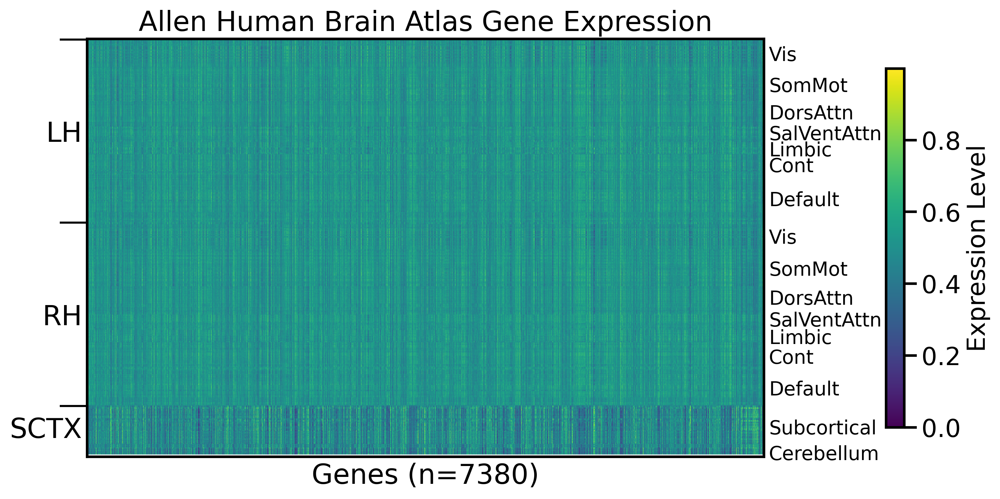

In [36]:
from data.data_load import *
from data.data_viz import * 

plot_transcriptome(parcellation='S400', sort_genes='refgenome')


Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 9du1oxjl
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/9du1oxjl
Initialized sweep with ID: 9du1oxjl


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 10}
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0314
Best val loss so far at epoch 2: 0.0270
Best val loss so far at epoch 3: 0.0265
Best val loss so far at epoch 4: 0.0248
Best val loss so far at epoch 5: 0.0235
Epoch 5/10, Train Loss: 0.0425, Val Loss: 0.0235, Time: 5.22s
Best val loss so far at epoch 6: 0.0229
Best val loss so far at epoch 7: 0.0220
Best val loss so far at epoch 8: 0.0219
Best val loss so far at epoch 9: 0.0202

Reached final epoch 10. Restoring best model with Val Loss: 0.0202, Pearson Correlation: 0.6583


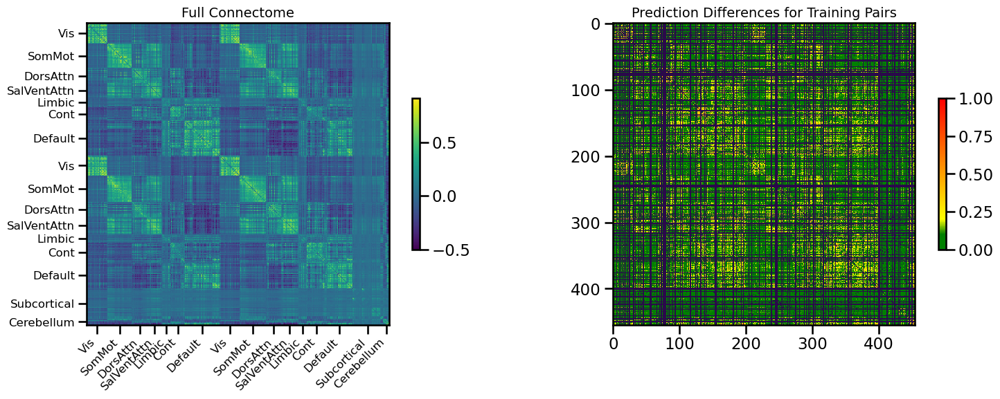

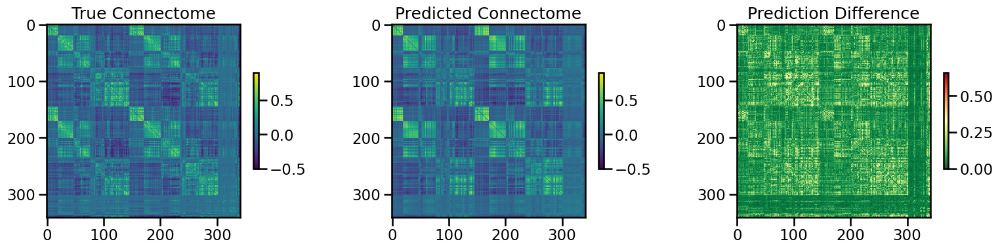

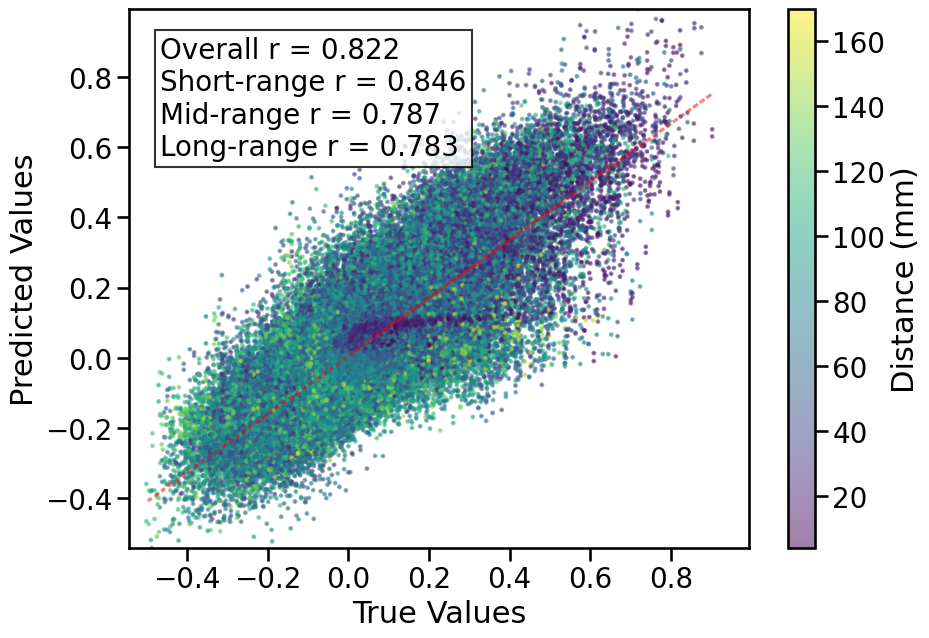

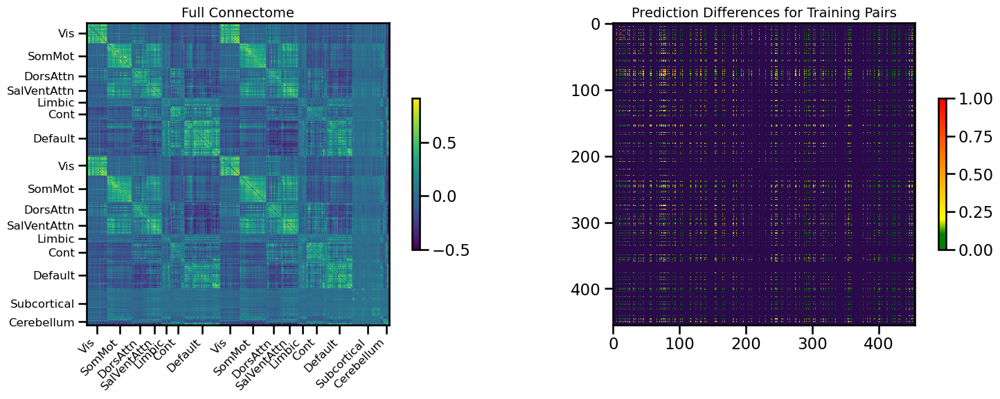

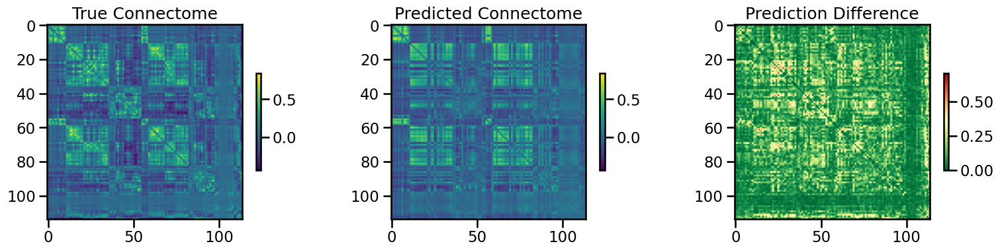

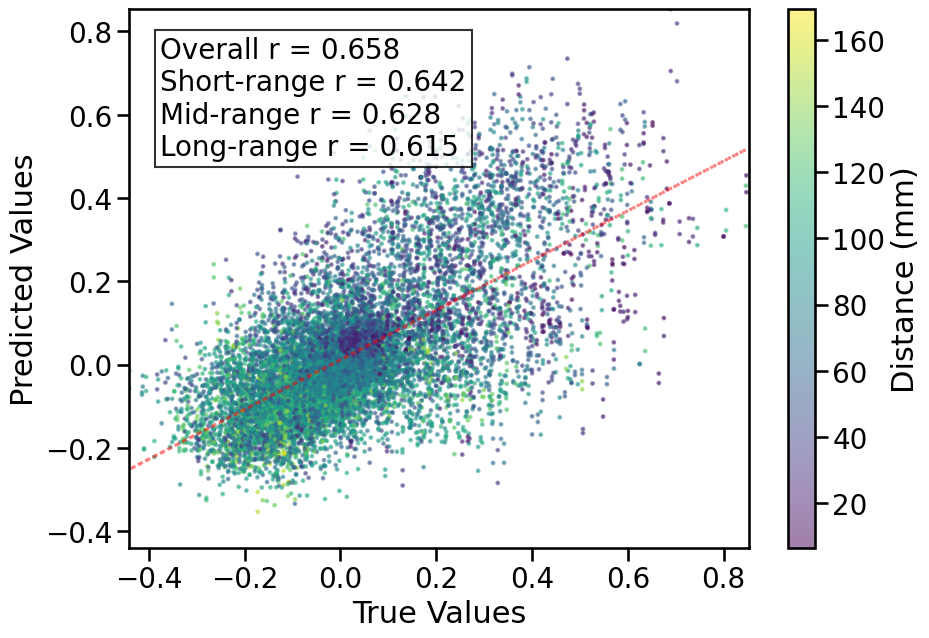


TRAIN METRICS: {'mse': 0.012209621, 'mae': 0.08138234, 'r2': 0.6395791802506066, 'pearson_r': 0.821656402438163, 'short_r': 0.8455523645356262, 'mid_r': 0.7870924372379806, 'long_r': 0.7829431803474168, 'geodesic_distance': 22.245130471028126}
TEST METRICS: {'mse': 0.020567544, 'mae': 0.10459935, 'r2': 0.37177615691055765, 'pearson_r': 0.6582825699061376, 'short_r': 0.6419955700776027, 'mid_r': 0.6281411037679421, 'long_r': 0.6147306594424654, 'geodesic_distance': 14.386078560213965}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 10}
CPU Usage: 0.3%
RAM Usage: 3.5%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  7% |
Simulation c

43287

In [28]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='none'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'n_components': 8, 'max_iter': 1000, 'scale': True, 'optimize_encoder': False, 'learning_rate': 0.0035, 'batch_size': 512, 'weight_decay': 0.0, 'epochs': 75}
X_train shape: torch.Size([341, 7380])
Y_train shape: torch.Size([341, 341])
cached_projection shape: torch.Size([455, 8])
x_projector shape: torch.Size([7380, 8])
x_loadings shape: torch.Size([7380, 8])
Total number of parameters: 118162


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 30.7468
Best val loss so far at epoch 2: 6.1130
Best val loss so far at epoch 3: 1.4369
Best val loss so far at epoch 4: 0.5493
Best val loss so far at epoch 5: 0.2599
Epoch 5/75, Train Loss: 0.4168, Val Loss: 0.2599, Time: 3.21s
Best val loss so far at epoch 6: 0.1318
Best val loss so far at epoch 7: 0.0715
Best val loss so far at epoch 8: 0.0440
Best val loss so far at epoch 9: 0.0322
Best val loss so far at epoch 10: 0.0282
Epoch 10/75, Train Loss: 0.0309, Val Loss: 0.0282, Time: 3.24s
Best val loss so far at epoch 11: 0.0259
Best val loss so far at epoch 14: 0.0246
Epoch 15/75, Train Loss: 0.0269, Val Loss: 0.0282, Time: 3.35s
Epoch 20/75, Train Loss: 0.0329, Val Loss: 0.0474, Time: 3.51s
Epoch 25/75, Train Loss: 0.0330, Val Loss: 0.0258, Time: 3.65s
Epoch 30/75, Train Loss: 0.0398, Val Loss: 0.0258, Time: 3.60s

LR REDUCED: 0.003500 → 0.001050 at Val Loss: 0.045174

Early st

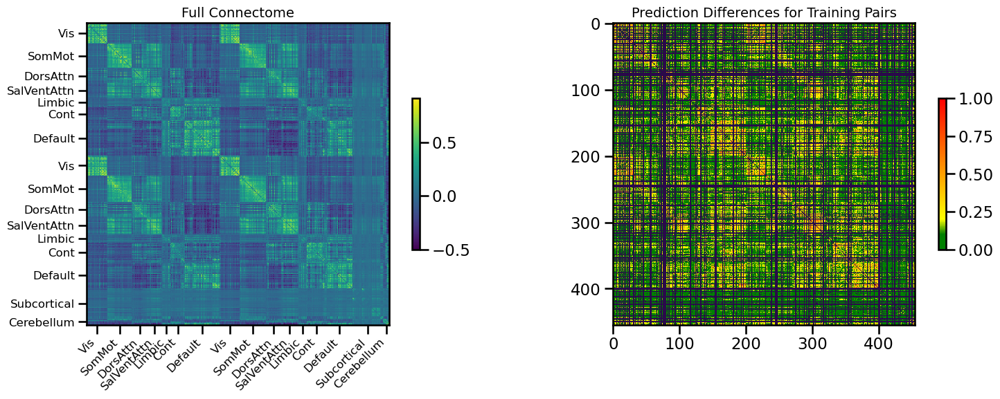

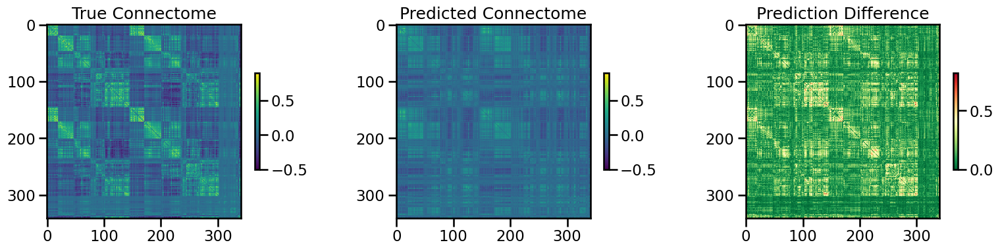

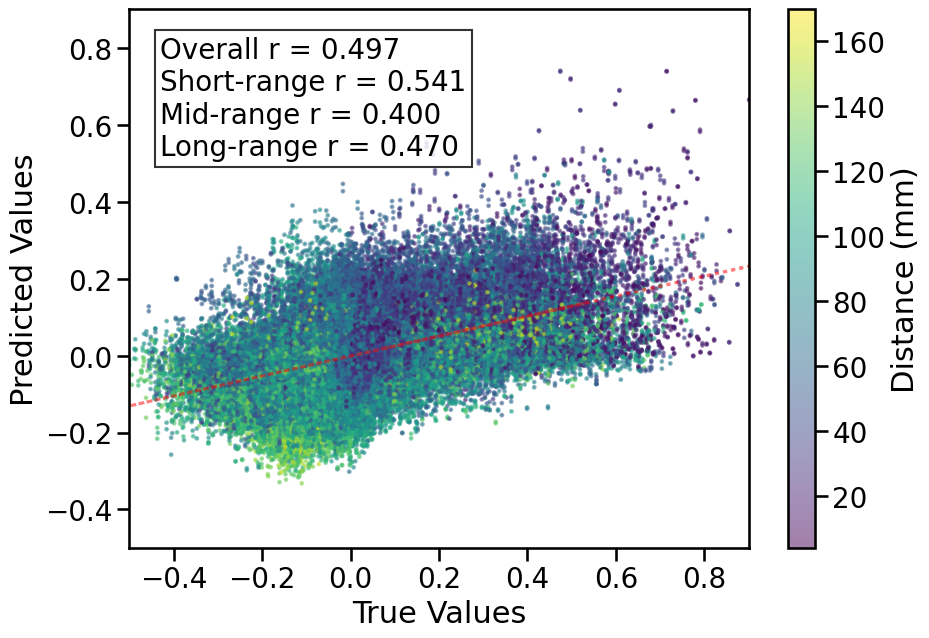

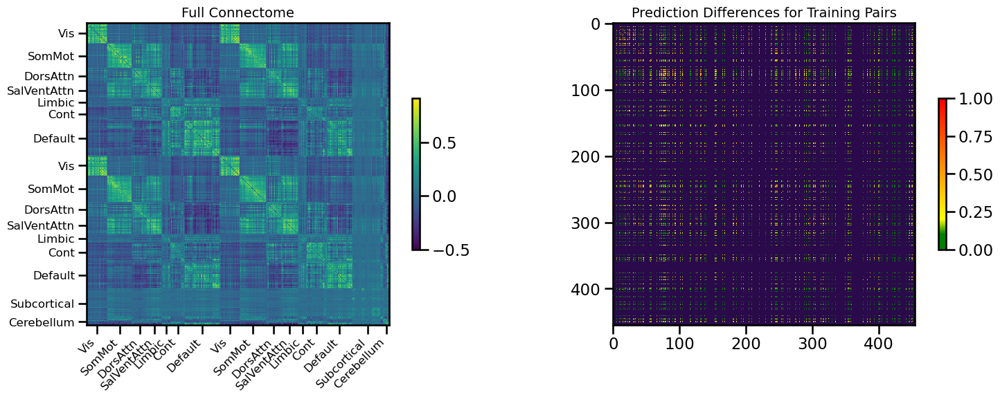

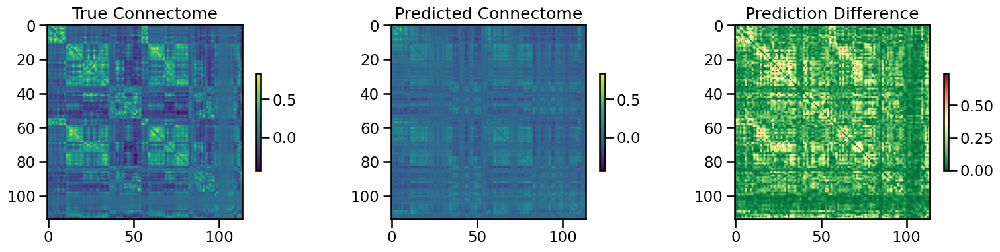

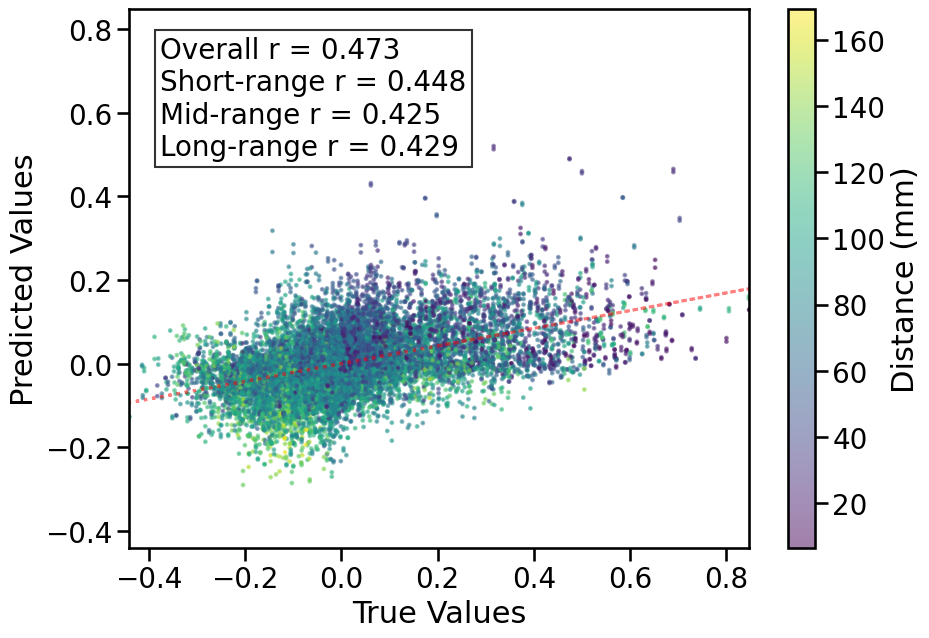


TRAIN METRICS: {'mse': 0.025724195, 'mae': 0.11938046, 'r2': 0.2406369212871502, 'pearson_r': 0.49684055560736234, 'short_r': 0.5413366370598307, 'mid_r': 0.39989991710689177, 'long_r': 0.4697557030312316, 'geodesic_distance': 41.133251415052136}
TEST METRICS: {'mse': 0.025782317, 'mae': 0.11923238, 'r2': 0.21249385512602403, 'pearson_r': 0.47343887686648656, 'short_r': 0.4484272166639793, 'mid_r': 0.42525346725410357, 'long_r': 0.4289681523362426, 'geodesic_distance': 23.537778335566973}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'binarize': False, 'optimize_encoder': False, 'batch_size': 512, 'epochs': 75}
1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'n_components': 8, 'max_iter': 1000, 'scale': True, 'optimize_encoder': False, 'learning_rate': 0.0035, 'batch_size': 512, 'weight_decay': 0.0, 'epochs': 75}
X_train shape: torch.Size([341, 7380])
Y_train shape: torch.Size([341, 341])


  warnings.warn(



cached_projection shape: torch.Size([455, 8])
x_projector shape: torch.Size([7380, 8])
x_loadings shape: torch.Size([7380, 8])
Total number of parameters: 118162
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 29.9522
Best val loss so far at epoch 2: 4.7184
Best val loss so far at epoch 3: 1.8260
Best val loss so far at epoch 4: 0.9544
Best val loss so far at epoch 5: 0.5355
Epoch 5/75, Train Loss: 1.0032, Val Loss: 0.5355, Time: 4.05s
Best val loss so far at epoch 6: 0.3493
Best val loss so far at epoch 7: 0.2391
Best val loss so far at epoch 8: 0.1839
Best val loss so far at epoch 9: 0.1454
Best val loss so far at epoch 10: 0.1177
Epoch 10/75, Train Loss: 0.1938, Val Loss: 0.1177, Time: 4.18s
Best val loss so far at epoch 11: 0.1009
Best val loss so far at epoch 12: 0.0824
Best val loss so far at epoch 13: 0.0700
Best val loss so far at epoch 14: 0.0595
Best val loss so far at epoch 15: 0.0523
Epoch 15/75, Train Loss: 0.0710

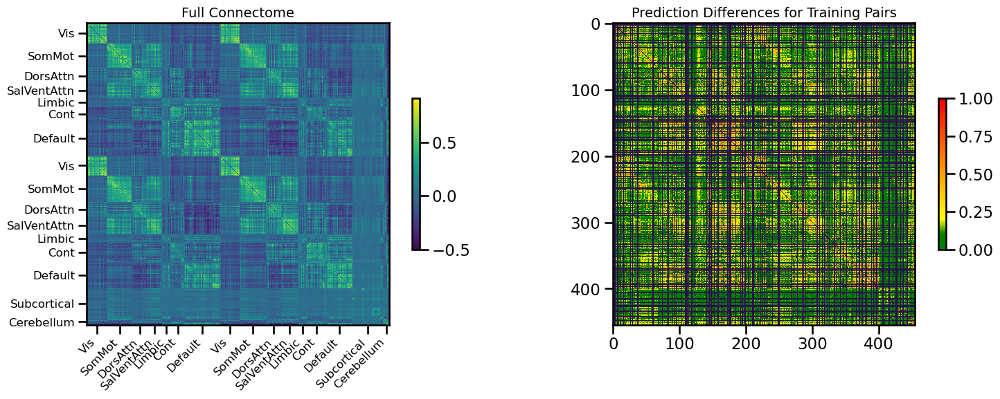

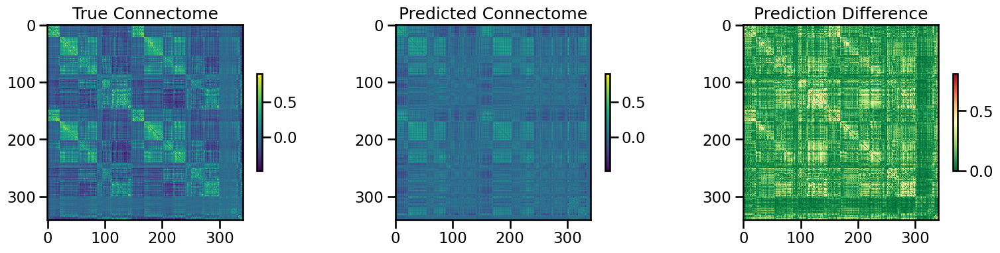

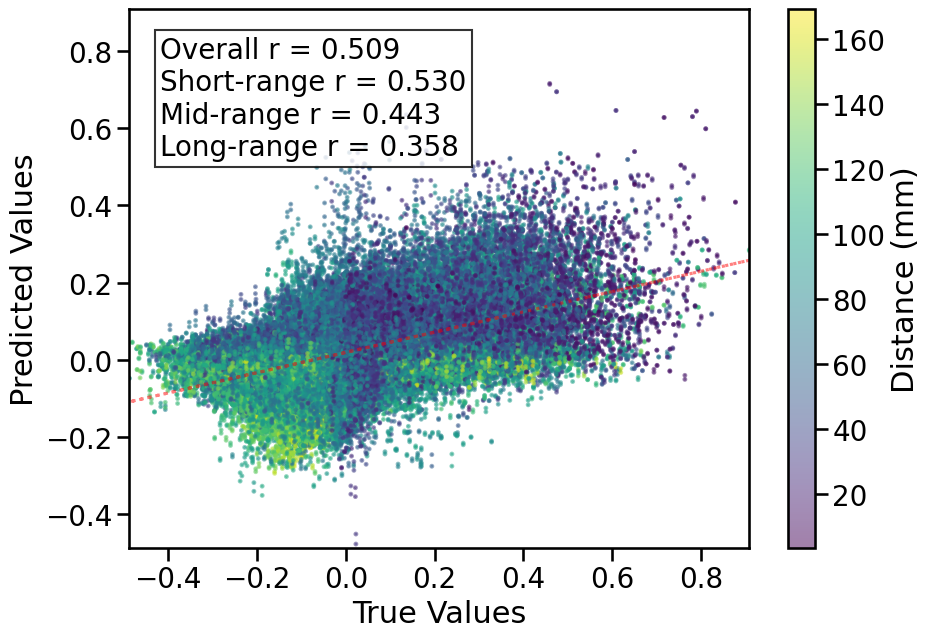

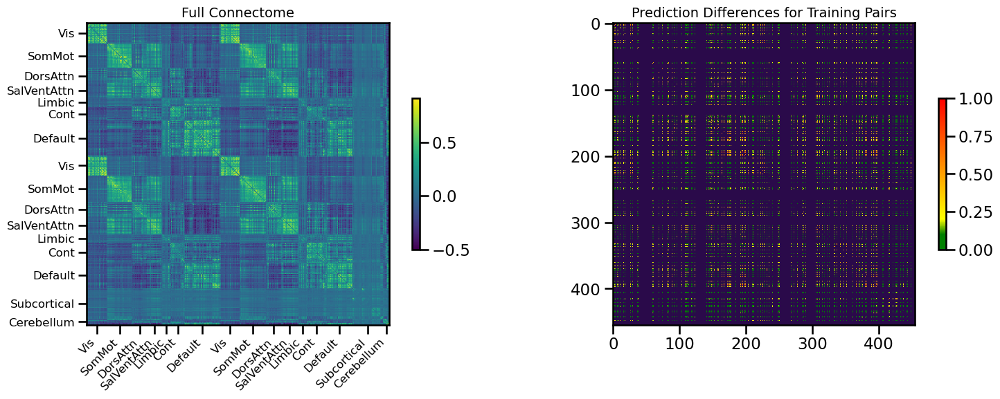

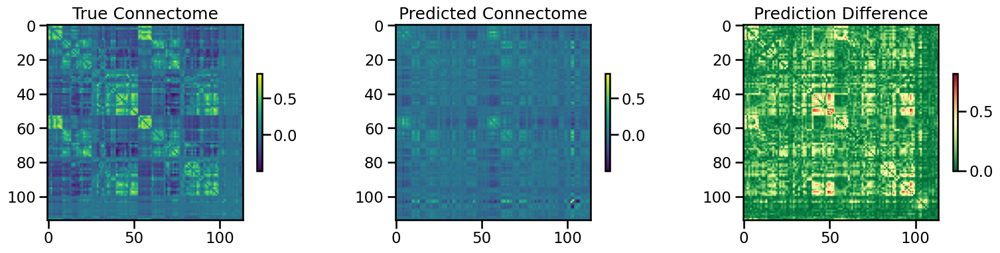

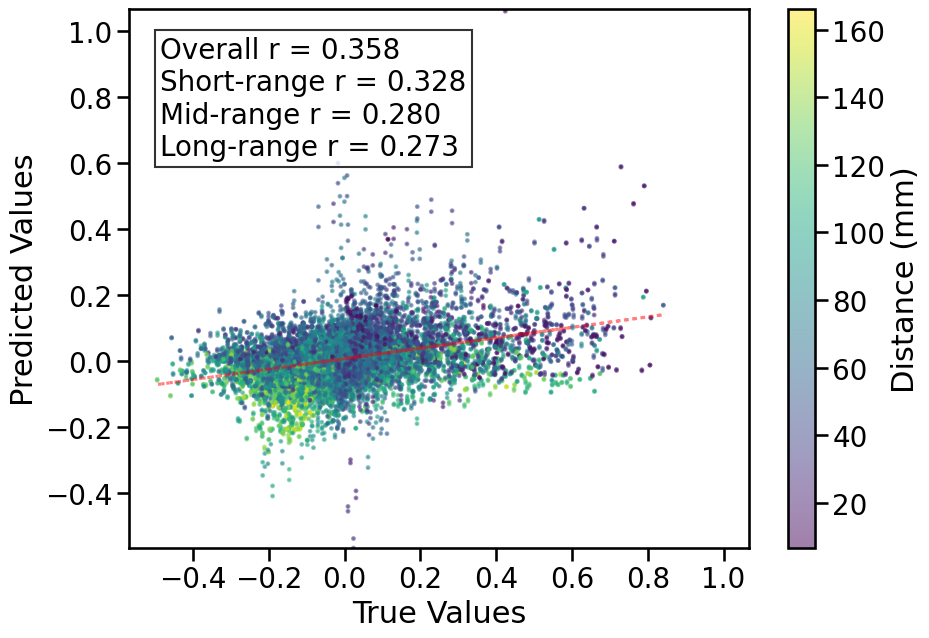


TRAIN METRICS: {'mse': 0.024698924, 'mae': 0.11889551, 'r2': 0.25792093950813877, 'pearson_r': 0.5087396093565895, 'short_r': 0.5295412445199176, 'mid_r': 0.4434551248370773, 'long_r': 0.35767874508795794, 'geodesic_distance': 36.53444106385346}
TEST METRICS: {'mse': 0.030827655, 'mae': 0.12724707, 'r2': 0.12033395854541185, 'pearson_r': 0.3584223388962495, 'short_r': 0.3278308534794852, 'mid_r': 0.2803803830636636, 'long_r': 0.27298871898533716, 'geodesic_distance': 23.197521377469663}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'binarize': False, 'optimize_encoder': False, 'batch_size': 512, 'epochs': 75}
1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'n_components': 8, 'max_iter': 1000, 'scale': True, 'optimize_encoder': False, 'learning_rate': 0.0035, 'batch_size': 512, 'weight_decay': 0.001, 'epochs': 75}
X_train shape: torch.Size([341, 7380])
Y_train shape: torch.Size([341, 341])


  warnings.warn(



cached_projection shape: torch.Size([455, 8])
x_projector shape: torch.Size([7380, 8])
x_loadings shape: torch.Size([7380, 8])
Total number of parameters: 118162
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 27.6424
Best val loss so far at epoch 2: 7.0932
Best val loss so far at epoch 3: 2.2471
Best val loss so far at epoch 4: 0.8118
Best val loss so far at epoch 5: 0.3717
Epoch 5/75, Train Loss: 0.6702, Val Loss: 0.3717, Time: 4.02s
Best val loss so far at epoch 6: 0.1940
Best val loss so far at epoch 7: 0.1016
Best val loss so far at epoch 8: 0.0652
Best val loss so far at epoch 9: 0.0482
Best val loss so far at epoch 10: 0.0399
Epoch 10/75, Train Loss: 0.0441, Val Loss: 0.0399, Time: 3.67s
Best val loss so far at epoch 11: 0.0331
Best val loss so far at epoch 12: 0.0307
Best val loss so far at epoch 15: 0.0290
Epoch 15/75, Train Loss: 0.0442, Val Loss: 0.0290, Time: 3.97s
Best val loss so far at epoch 19: 0.0281
Epoch 20/

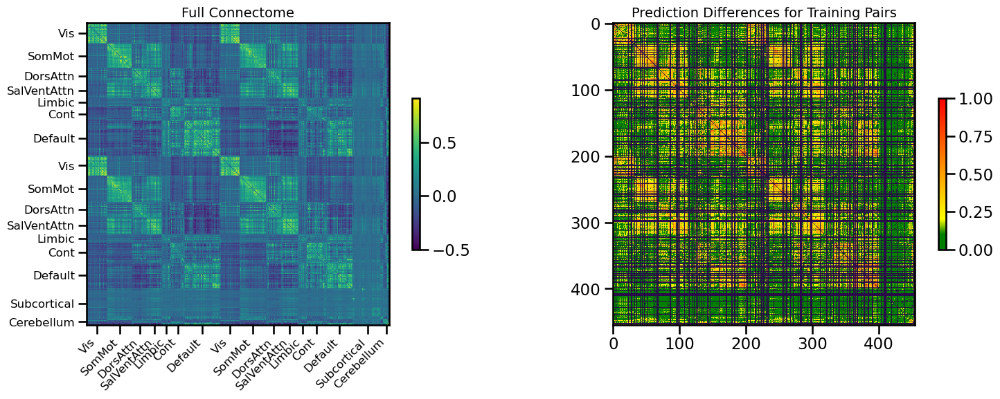

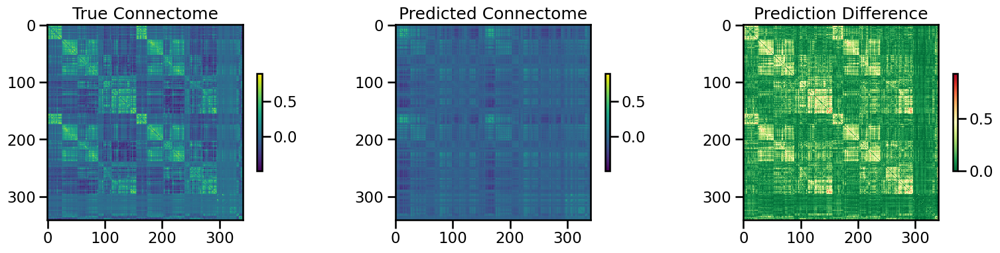

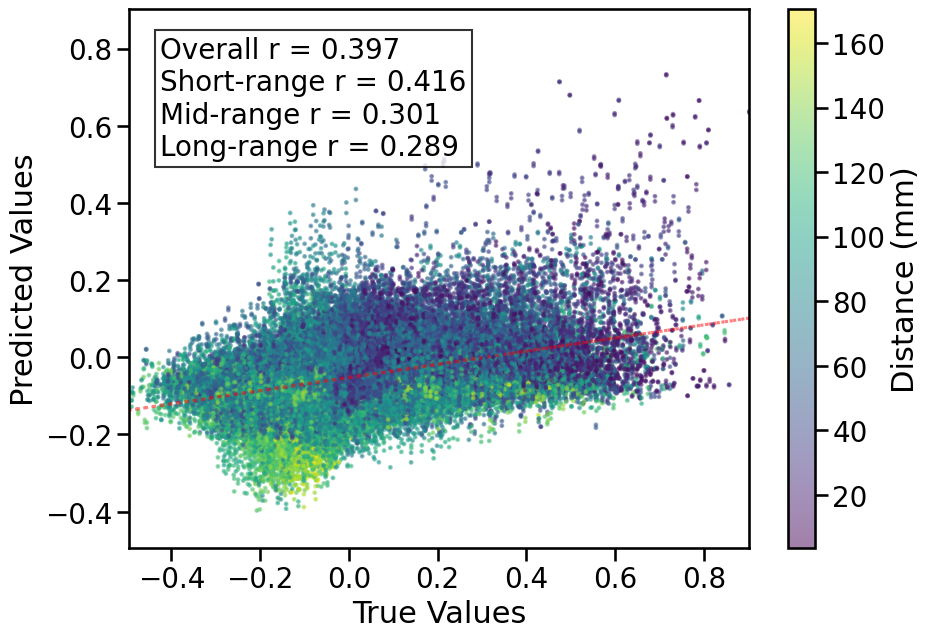

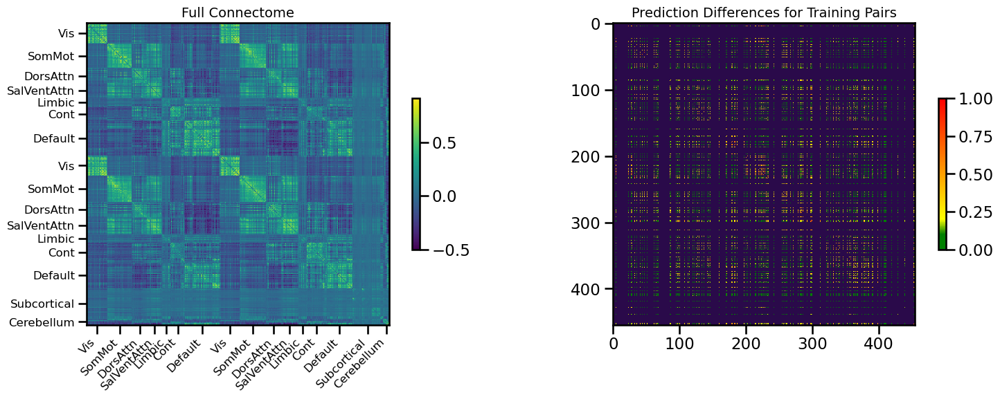

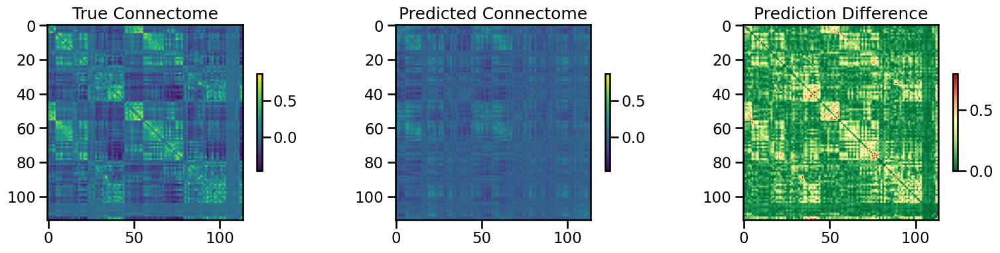

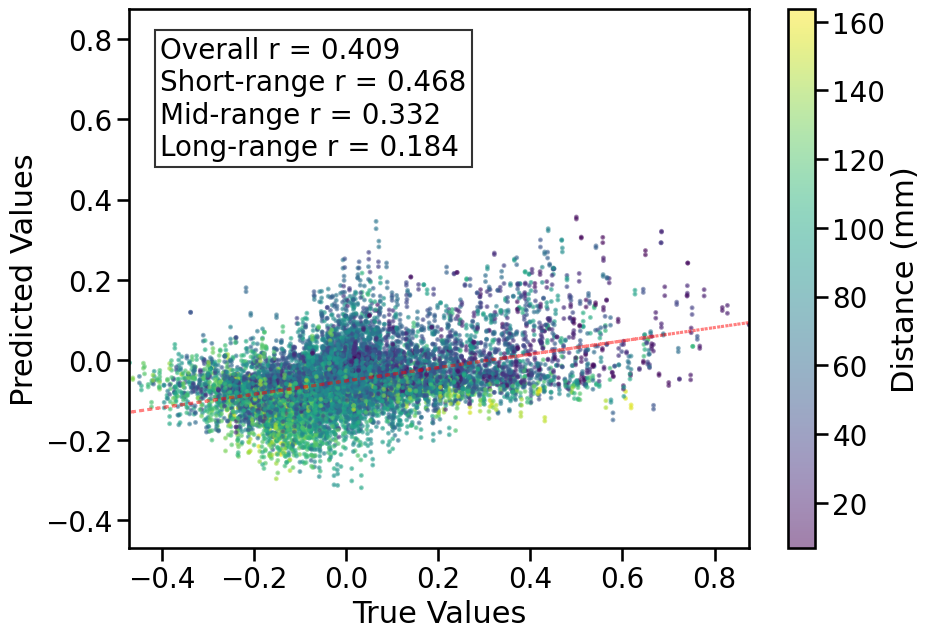


TRAIN METRICS: {'mse': 0.032337483, 'mae': 0.13068101, 'r2': 0.023670096948401387, 'pearson_r': 0.396783128594416, 'short_r': 0.41597273429221276, 'mid_r': 0.3014323252030926, 'long_r': 0.2886737161435072, 'geodesic_distance': 52.601174414990034}
TEST METRICS: {'mse': 0.032675013, 'mae': 0.13175412, 'r2': 0.037720499031224985, 'pearson_r': 0.4090564523138499, 'short_r': 0.4675007483132736, 'mid_r': 0.33164107146616084, 'long_r': 0.18373503142946587, 'geodesic_distance': 30.274322003429607}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'binarize': False, 'optimize_encoder': False, 'batch_size': 512, 'epochs': 75}
1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'n_components': 8, 'max_iter': 1000, 'scale': True, 'optimize_encoder': False, 'learning_rate': 0.0035, 'batch_size': 512, 'weight_decay': 0.001, 'epochs': 75}
X_train shape: torch.Size([342, 7380])
Y_train shape: torch.Size([342, 342])


  warnings.warn(



cached_projection shape: torch.Size([455, 8])
x_projector shape: torch.Size([7380, 8])
x_loadings shape: torch.Size([7380, 8])
Total number of parameters: 118162
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 10.3983
Best val loss so far at epoch 2: 1.0993
Best val loss so far at epoch 3: 0.2666
Best val loss so far at epoch 4: 0.0952
Best val loss so far at epoch 5: 0.0483
Epoch 5/75, Train Loss: 0.0669, Val Loss: 0.0483, Time: 3.88s
Best val loss so far at epoch 6: 0.0341
Best val loss so far at epoch 7: 0.0297
Best val loss so far at epoch 8: 0.0286
Best val loss so far at epoch 9: 0.0279
Epoch 10/75, Train Loss: 0.0282, Val Loss: 0.0285, Time: 3.64s
Best val loss so far at epoch 15: 0.0278
Epoch 15/75, Train Loss: 0.0297, Val Loss: 0.0278, Time: 3.74s
Epoch 20/75, Train Loss: 0.0358, Val Loss: 0.0374, Time: 3.92s
Epoch 25/75, Train Loss: 0.0389, Val Loss: 0.0299, Time: 3.68s

LR REDUCED: 0.003500 → 0.001050 at Val Loss: 0

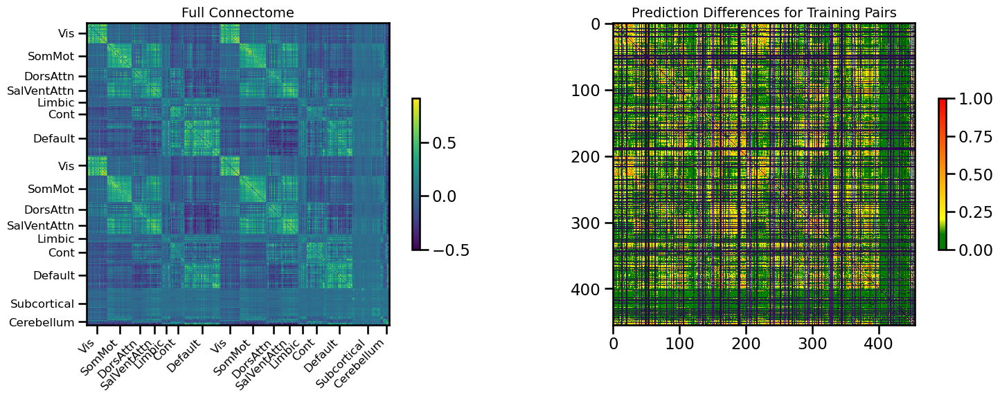

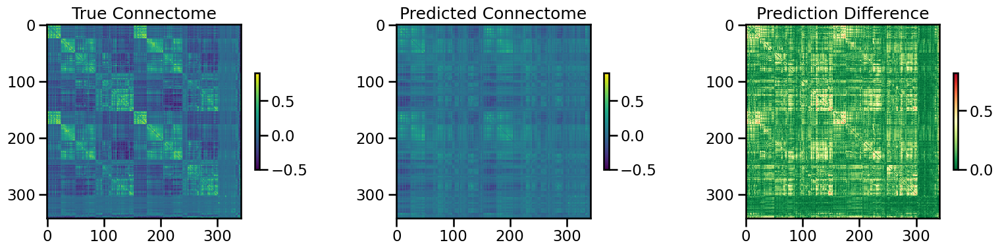

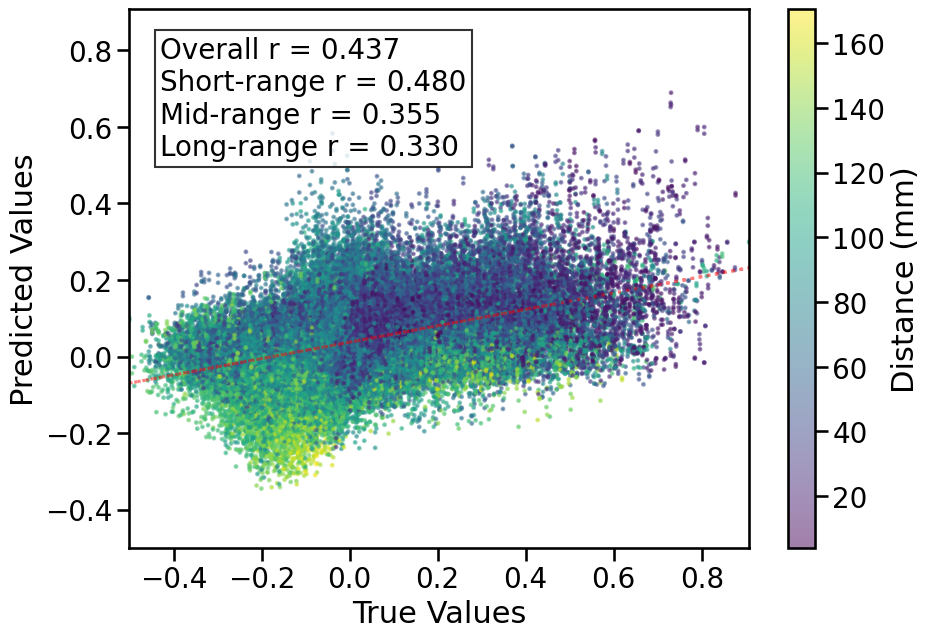

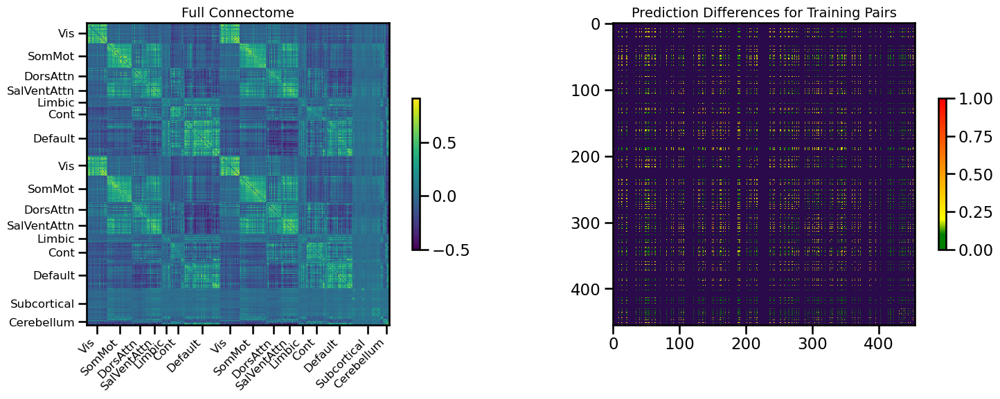

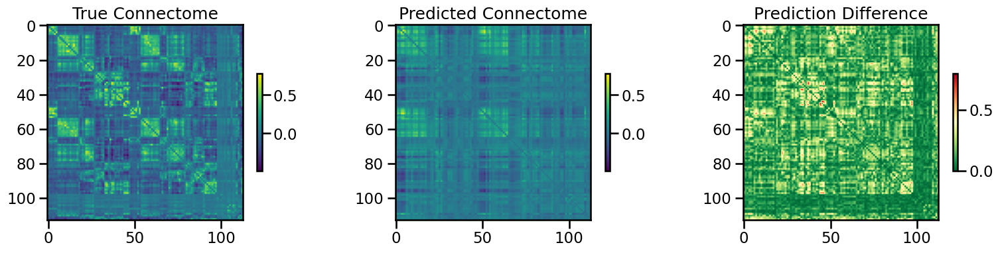

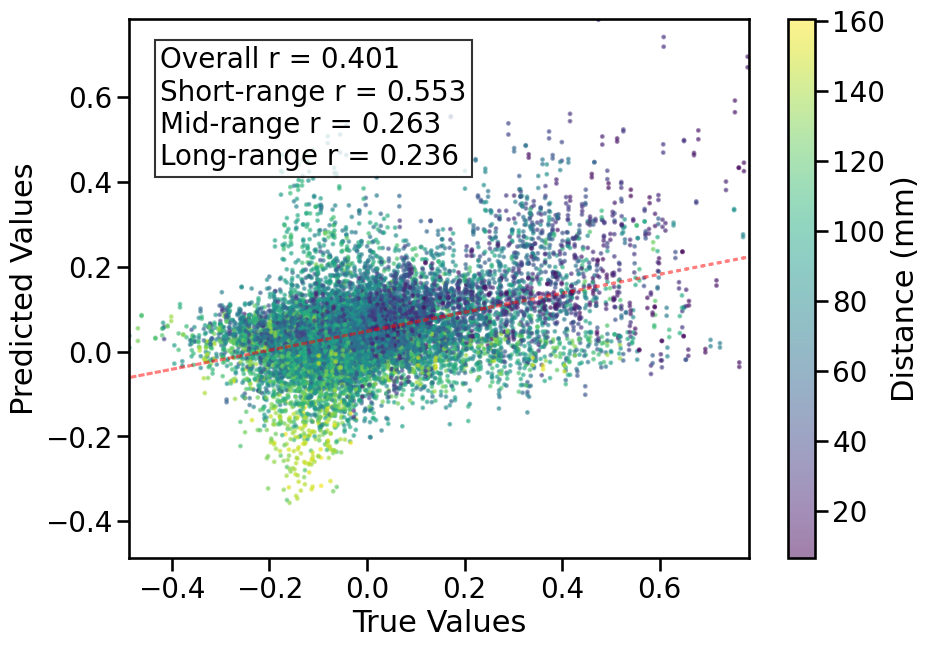


TRAIN METRICS: {'mse': 0.028144423, 'mae': 0.1271937, 'r2': 0.17025405779705027, 'pearson_r': 0.43731543408164747, 'short_r': 0.48043992612621295, 'mid_r': 0.35501920748413995, 'long_r': 0.3302513611942555, 'geodesic_distance': 34.61449664213199}
TEST METRICS: {'mse': 0.029434243, 'mae': 0.13160983, 'r2': 0.10379157042796106, 'pearson_r': 0.4012274430466382, 'short_r': 0.5531472194680279, 'mid_r': 0.2634632848366412, 'long_r': 0.23623192301231366, 'geodesic_distance': 19.162948246801825}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'binarize': False, 'optimize_encoder': False, 'batch_size': 512, 'epochs': 75}
CPU Usage: 1.5%
RAM Usage: 5.1%
Available RAM: 955.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Simulation completed in 940.21 seconds (15.67 minutes)


36390

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='pls_lineardecoder',
              use_gpu=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome_PCA
processing_type:  None
features ['transcriptome_PCA']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 54, 'binarize': False, 'learning_rate': 0.003, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001, 'epochs': 100}
Number of learnable parameters in bilinear SCM layer: 730


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 1.0297
Best val loss so far at epoch 2: 0.1172
Best val loss so far at epoch 3: 0.0359
Best val loss so far at epoch 4: 0.0258
Best val loss so far at epoch 5: 0.0247
Epoch 5/100, Train Loss: 0.0236, Val Loss: 0.0247, Time: 1.23s
Epoch 10/100, Train Loss: 0.0238, Val Loss: 0.0249, Time: 1.23s
Epoch 15/100, Train Loss: 0.0248, Val Loss: 0.0278, Time: 1.23s
Epoch 20/100, Train Loss: 0.0733, Val Loss: 0.2277, Time: 1.23s
Epoch 25/100, Train Loss: 0.0297, Val Loss: 0.0414, Time: 1.56s
Epoch 30/100, Train Loss: 0.0351, Val Loss: 0.1315, Time: 1.24s
Epoch 35/100, Train Loss: 0.0618, Val Loss: 0.1281, Time: 1.23s
Epoch 40/100, Train Loss: 0.0308, Val Loss: 0.0391, Time: 1.23s
Epoch 45/100, Train Loss: 0.0915, Val Loss: 0.3073, Time: 1.24s
Epoch 50/100, Train Loss: 0.1011, Val Loss: 0.2055, Time: 1.23s
Epoch 55/100, Train Loss: 0.0477, Val Loss: 0.0480, Time: 1.23s
Epoch 60/100, Train Lo

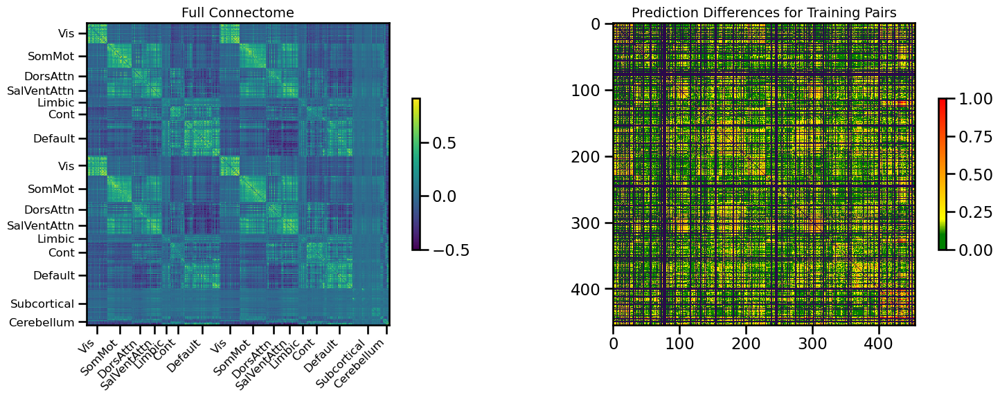

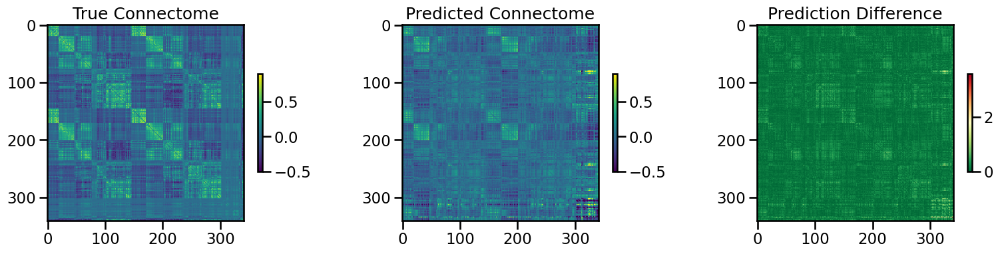

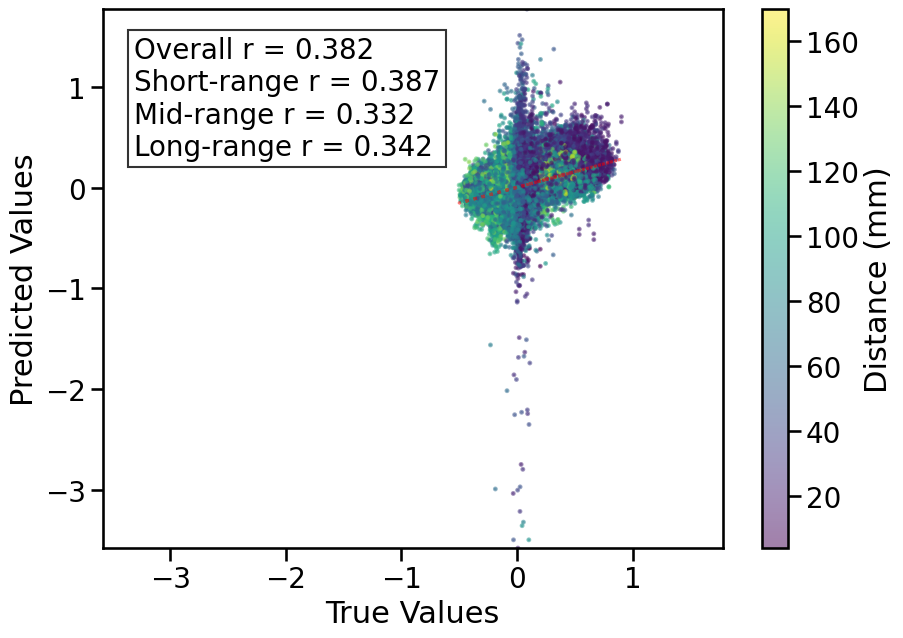

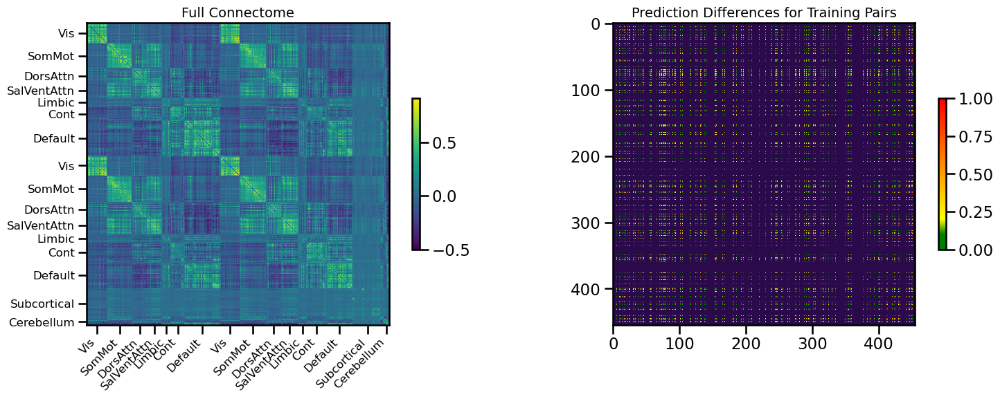

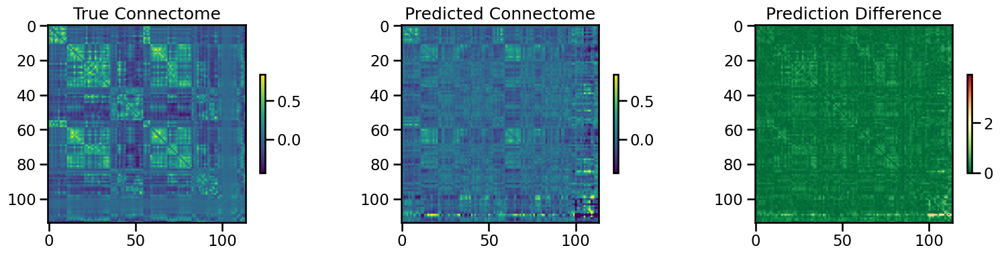

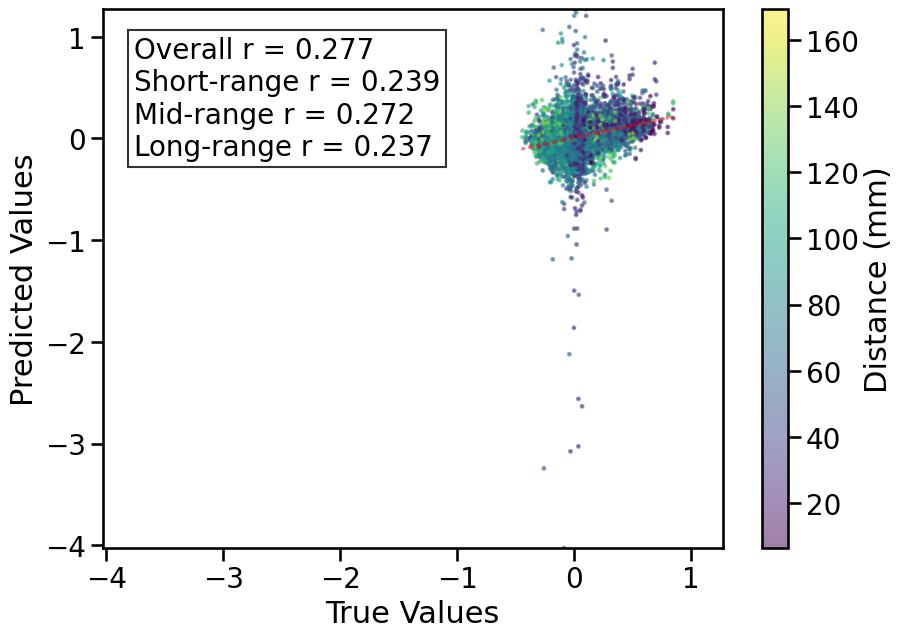


TRAIN METRICS: {'mse': 0.03523219, 'mae': 0.14032777, 'r2': -0.04003362059461835, 'pearson_r': 0.38249499037458423, 'short_r': 0.38683979083184383, 'mid_r': 0.3316326352236563, 'long_r': 0.34163921057707786, 'geodesic_distance': 33.91040636430233}
TEST METRICS: {'mse': 0.04264158, 'mae': 0.14694062, 'r2': -0.3024625622466286, 'pearson_r': 0.2767420513250521, 'short_r': 0.23859897375362482, 'mid_r': 0.2718303516462277, 'long_r': 0.23683122773786627, 'geodesic_distance': 17.84732726170849}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'learning_rate': 0.003, 'epochs': 100, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 54, 'binarize': False, 'learning_rate': 0.003, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001, 'epochs': 100}
Number of learnable parameters in bilinear SCM layer: 730
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.5573
Best val loss so far at epoch 2: 0.0776
Best val loss so far at epoch 3: 0.0313
Best val loss so far at epoch 4: 0.0266
Best val loss so far at epoch 5: 0.0262
Epoch 5/100, Train Loss: 0.0229, Val Loss: 0.0262, Time: 1.59s
Epoch 10/100, Train Loss: 0.0237, Val Loss: 0.0278, Time: 1.29s
Epoch 15/100, Train Loss: 0.0352, Val Loss: 0.0530, Time: 1.29s
Epoch 20/100, Train Loss: 0.0357, Val Loss: 0.0318, Time: 1.28s
Epoch 25/100, Train Loss: 0.0297, Val Loss: 0.0322, Time: 1.28s
Epoch 30/100, Train Loss: 0.1012, Val Loss: 0.0869, Time: 1.26s
Epoch 35/100, Train Loss: 0.0328, Val Loss: 0.0527, Time: 1.26s
Epoch 40/100, Train Loss: 0.0739, Val Loss: 0.0527, Time: 1.54

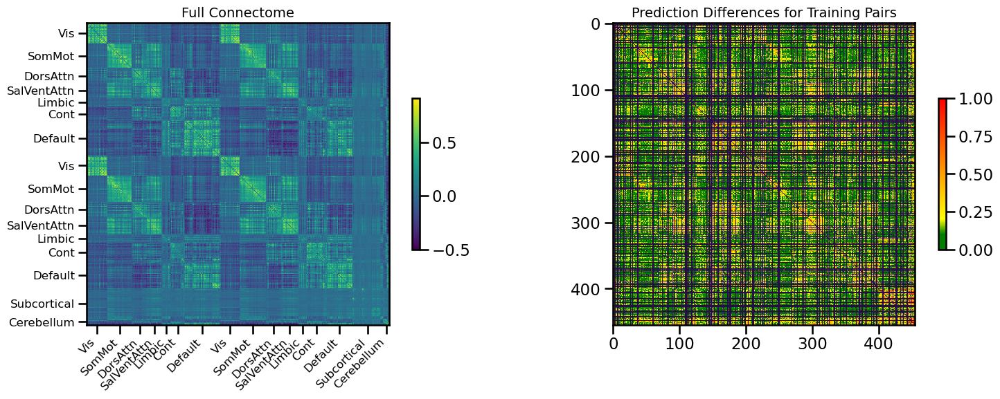

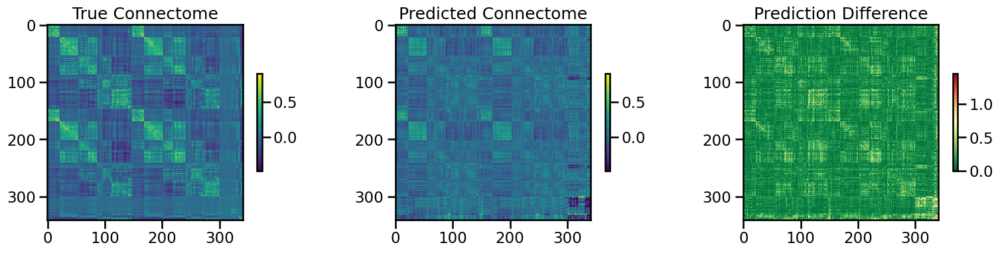

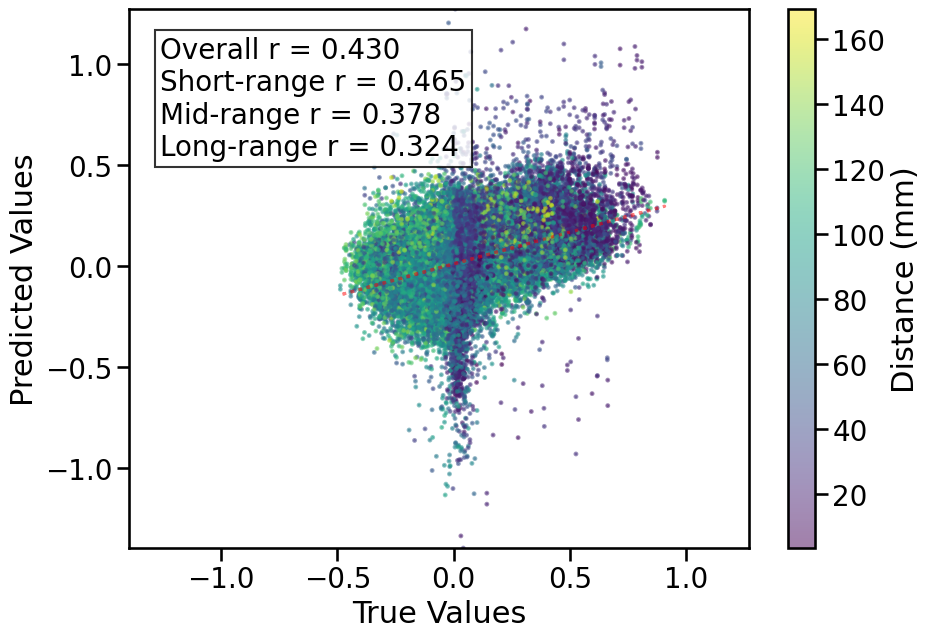

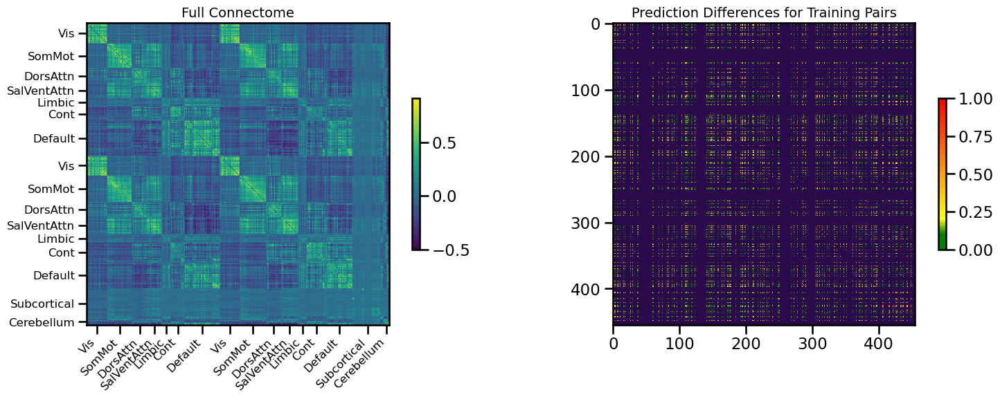

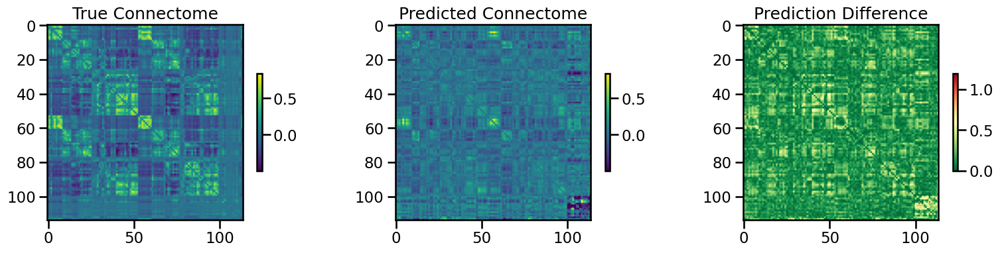

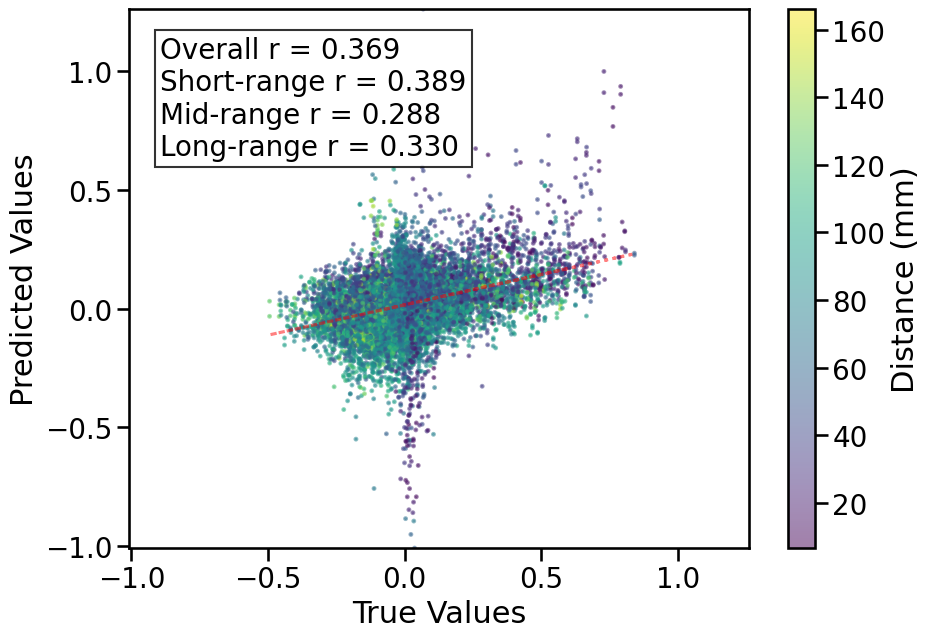


TRAIN METRICS: {'mse': 0.030121138, 'mae': 0.13226844, 'r2': 0.0950105622909575, 'pearson_r': 0.4302649874068641, 'short_r': 0.4650602455682315, 'mid_r': 0.37758332292836655, 'long_r': 0.3240246603039714, 'geodesic_distance': 28.98703430951115}
TEST METRICS: {'mse': 0.033997733, 'mae': 0.1423752, 'r2': 0.02987583305030539, 'pearson_r': 0.36871591636338485, 'short_r': 0.38869618298472497, 'mid_r': 0.2879496145445596, 'long_r': 0.3303736465896344, 'geodesic_distance': 17.454971460653535}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'learning_rate': 0.003, 'epochs': 100, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 54, 'binarize': False, 'learning_rate': 0.003, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001, 'epochs': 100}
Number of learnable parameters in bilinear SCM layer: 730
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.9746
Best val loss so far at epoch 2: 0.1537
Best val loss so far at epoch 3: 0.0477
Best val loss so far at epoch 4: 0.0294
Best val loss so far at epoch 5: 0.0265
Epoch 5/100, Train Loss: 0.0235, Val Loss: 0.0265, Time: 1.28s
Best val loss so far at epoch 6: 0.0256
Epoch 10/100, Train Loss: 0.0232, Val Loss: 0.0257, Time: 1.26s
Epoch 15/100, Train Loss: 0.0241, Val Loss: 0.0265, Time: 1.26s
Epoch 20/100, Train Loss: 0.0364, Val Loss: 0.0372, Time: 1.26s
Epoch 25/100, Train Loss: 0.0263, Val Loss: 0.0286, Time: 1.53s
Epoch 30/100, Train Loss: 0.0312, Val Loss: 0.0338, Time: 1.56s
Epoch 35/100, Train Loss: 0.0395, Val Loss: 0.0561, Time: 1.26s
Epoch 40/100, Train Lo

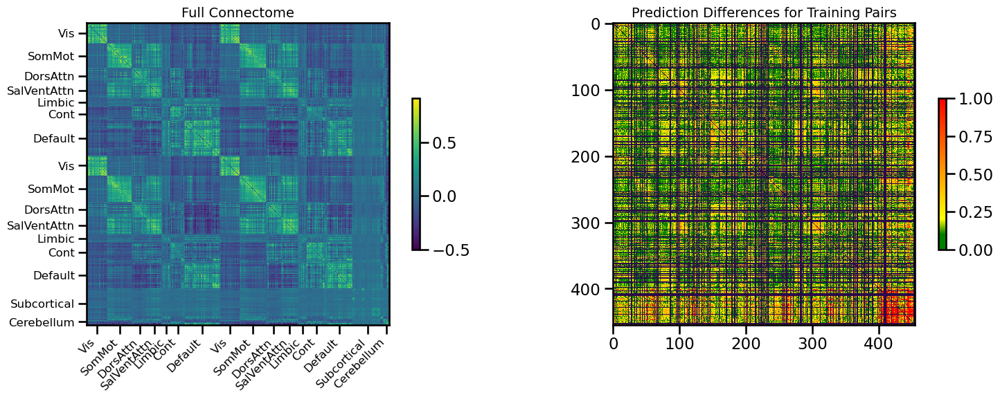

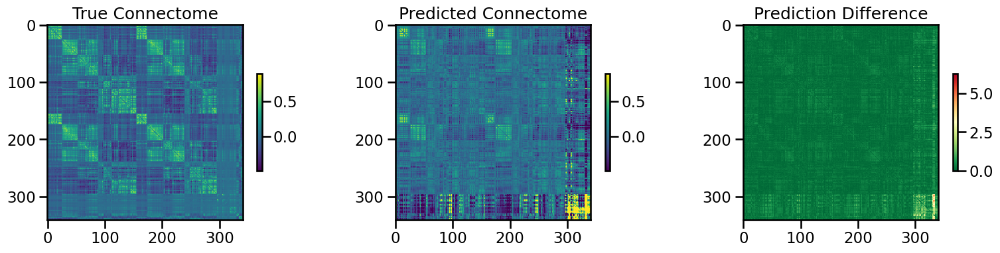

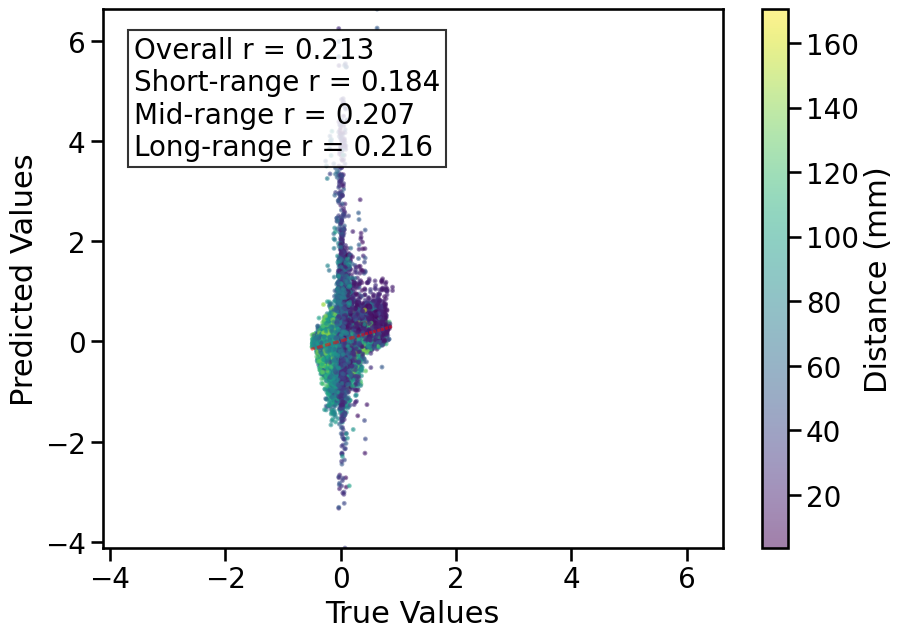

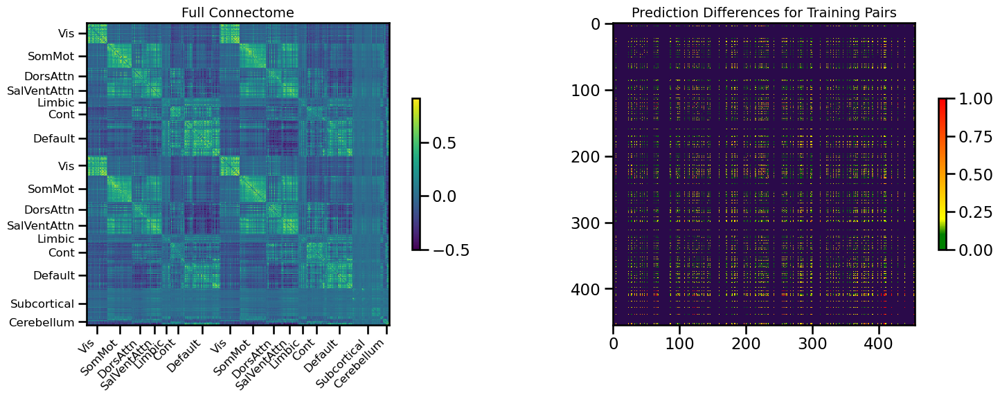

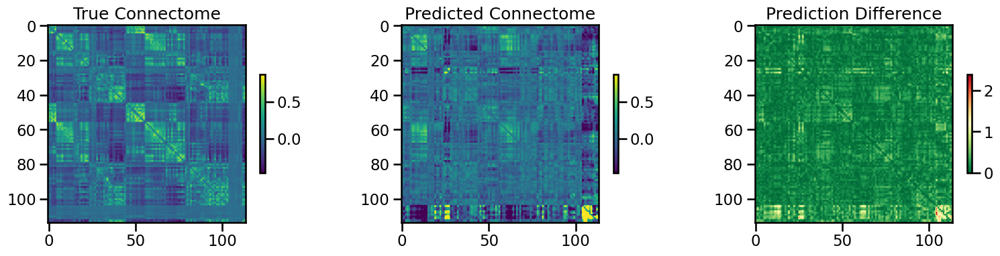

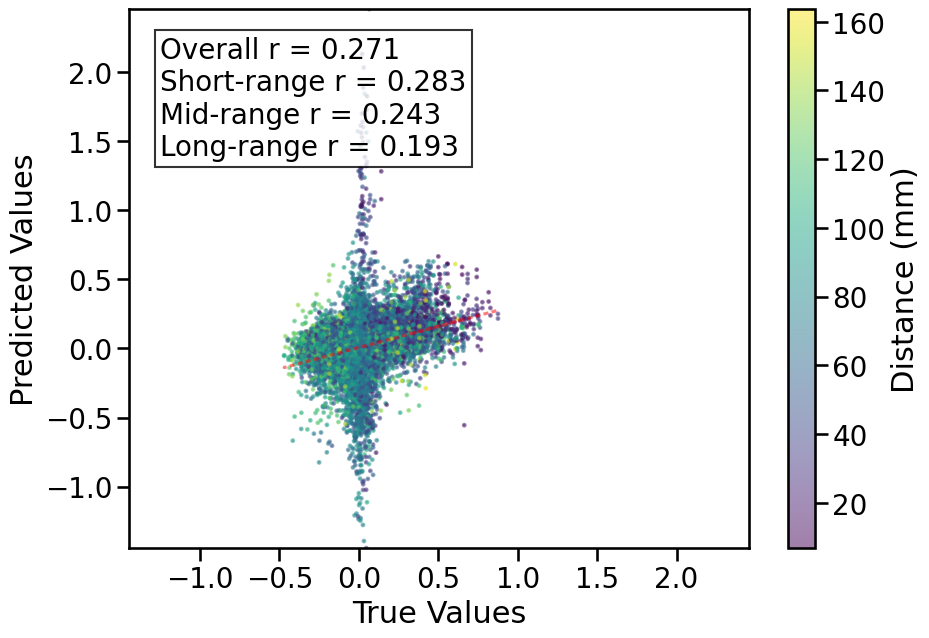


TRAIN METRICS: {'mse': 0.08793812, 'mae': 0.18940869, 'r2': -1.655018355470164, 'pearson_r': 0.21322996666718624, 'short_r': 0.18429868700974378, 'mid_r': 0.20675010804060337, 'long_r': 0.21590882034688424, 'geodesic_distance': 35.359415864350055}
TEST METRICS: {'mse': 0.056896124, 'mae': 0.17126086, 'r2': -0.6755914550455842, 'pearson_r': 0.2708992193497943, 'short_r': 0.2833871952989291, 'mid_r': 0.2429094278755994, 'long_r': 0.1925454631318418, 'geodesic_distance': 19.127493661888902}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'learning_rate': 0.003, 'epochs': 100, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 54, 'binarize': False, 'learning_rate': 0.003, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001, 'epochs': 100}
Number of learnable parameters in bilinear SCM layer: 730
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.3934
Best val loss so far at epoch 2: 0.0487
Best val loss so far at epoch 3: 0.0271
Best val loss so far at epoch 4: 0.0250
Best val loss so far at epoch 5: 0.0250
Epoch 5/100, Train Loss: 0.0236, Val Loss: 0.0250, Time: 1.29s
Epoch 10/100, Train Loss: 0.0245, Val Loss: 0.0260, Time: 1.57s
Epoch 15/100, Train Loss: 0.0353, Val Loss: 0.0374, Time: 1.29s
Epoch 20/100, Train Loss: 0.1333, Val Loss: 0.0832, Time: 1.27s
Epoch 25/100, Train Loss: 0.0925, Val Loss: 0.0474, Time: 1.28s
Epoch 30/100, Train Loss: 0.1562, Val Loss: 0.0781, Time: 1.55s
Epoch 35/100, Train Loss: 0.0588, Val Loss: 0.1427, Time: 1.27s
Epoch 40/100, Train Loss: 0.0288, Val Loss: 0.0355, Time: 1.28

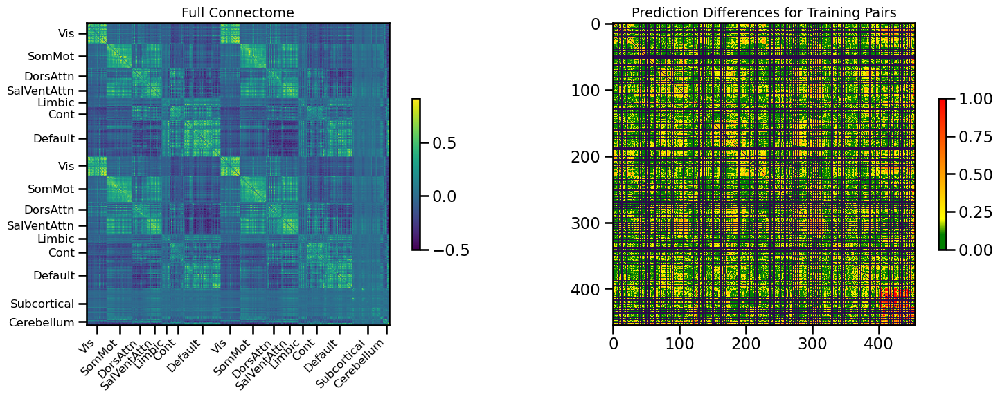

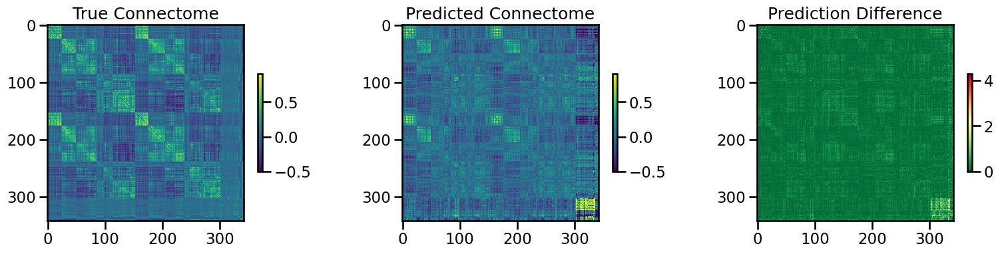

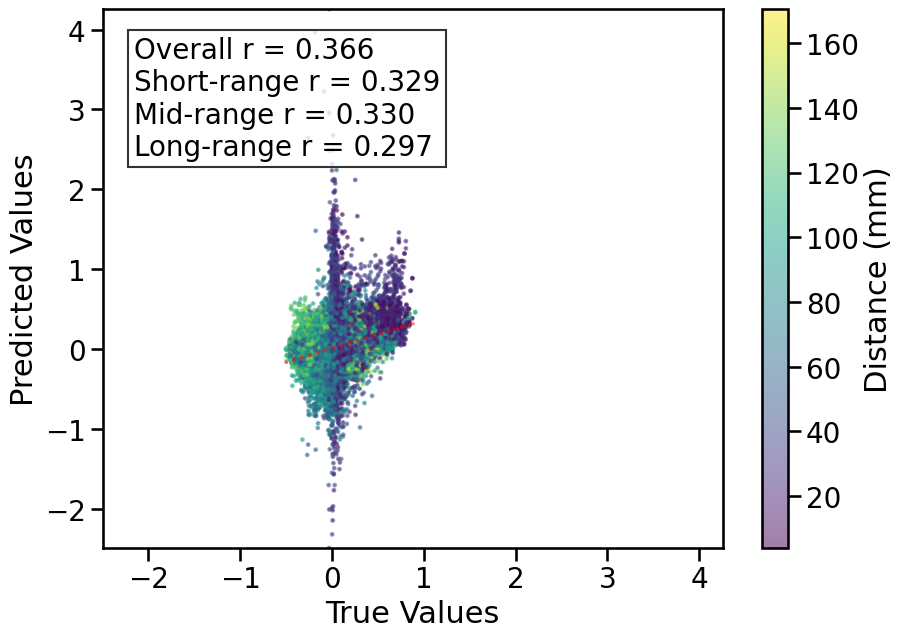

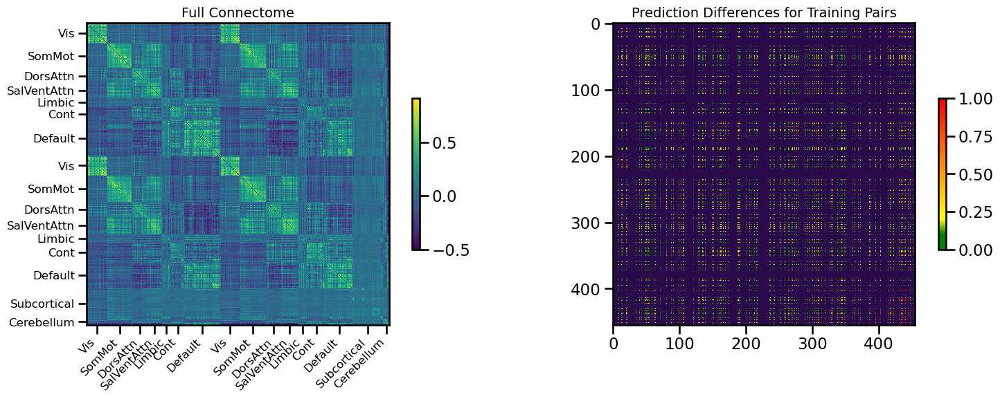

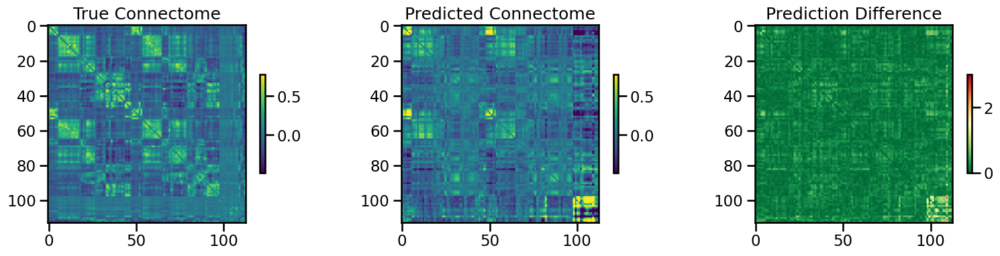

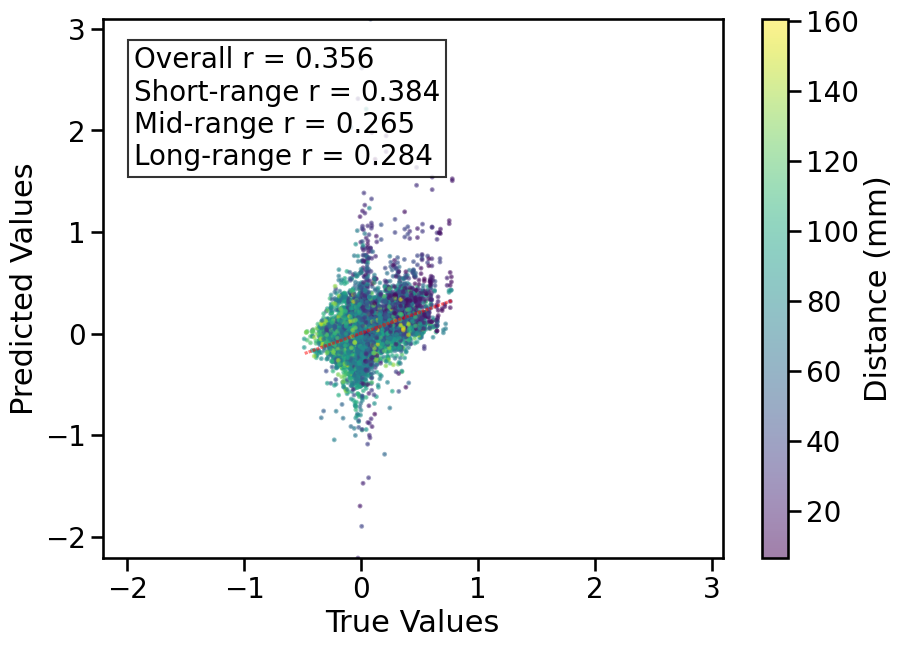


TRAIN METRICS: {'mse': 0.04107914, 'mae': 0.1488349, 'r2': -0.2110836909586833, 'pearson_r': 0.3663820924284387, 'short_r': 0.3294347644296631, 'mid_r': 0.32953077060687974, 'long_r': 0.29663099933705683, 'geodesic_distance': 29.125714517466275}
TEST METRICS: {'mse': 0.05000207, 'mae': 0.16059133, 'r2': -0.5224539890863196, 'pearson_r': 0.3558780658485103, 'short_r': 0.384365398539747, 'mid_r': 0.2652758882790257, 'long_r': 0.2838644707708773, 'geodesic_distance': 16.048957156553524}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'learning_rate': 0.003, 'epochs': 100, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.001}
CPU Usage: 1.3%
RAM Usage: 3.3%
Available RAM: 973.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Simulation completed in 577.90 seconds (9.63 minutes)


36390

In [8]:
single_sim_run(
              feature_type=[{'transcriptome_PCA': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='chromosome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_CM',
              use_gpu=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 34
Number of 1s: 3362, Number of 0s: 9634, Class balance (1s): 0.259
Number of 1s: 3220, Number of 0s: 9776, Class balance (1s): 0.248
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X shape (114, 10760)

 Test fold num: 1 X_train shape: (7140, 21520) Y_train shape: (7140,) X_test shape: (812, 21520) Y_test shape: (812,)
2
3
4
Fitting 3 folds for each of 5 candidates, totalling 15 fits
[CV 1/3] END colsample_bytree=0.8, device=cuda, learning_rate=0.3, max_depth=3, n_estimators=250, n_gpus=-1, random_state=42, reg_alpha=0.1, reg_lambda=0.0001, subsample=0.8, tree_method=gpu_hist, verbosity=0;, score=(train=-0.000, test=-0.011) total time=   3.8s
[CV 2/3] END colsample_bytree=0.8, device=cuda, learning_rate=0.3, ma

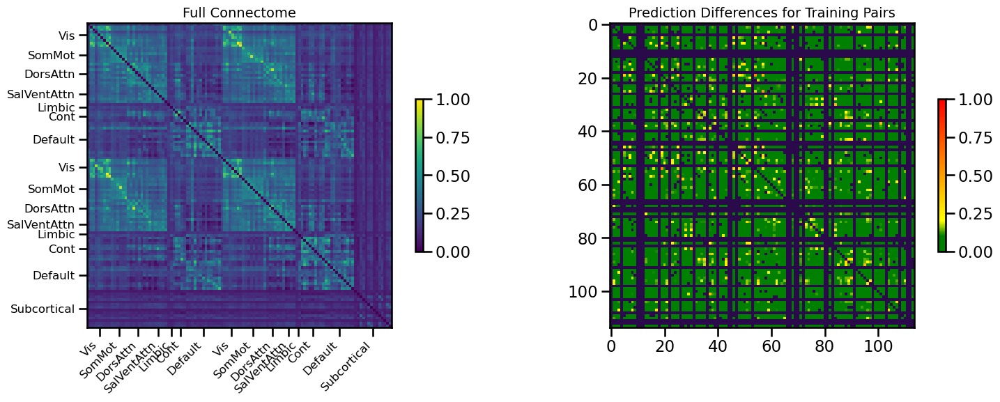

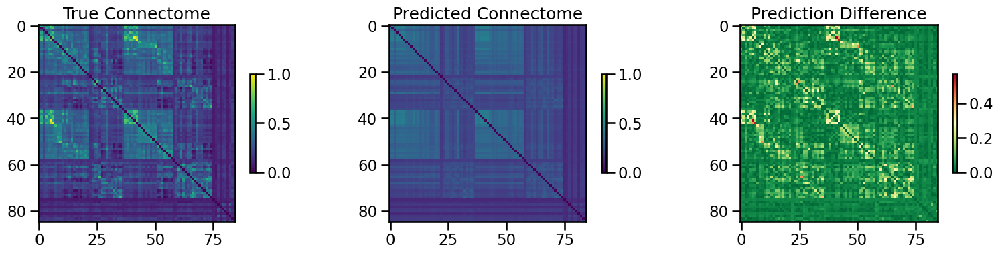

No scatter plot visualization for this model


<Figure size 1000x700 with 0 Axes>

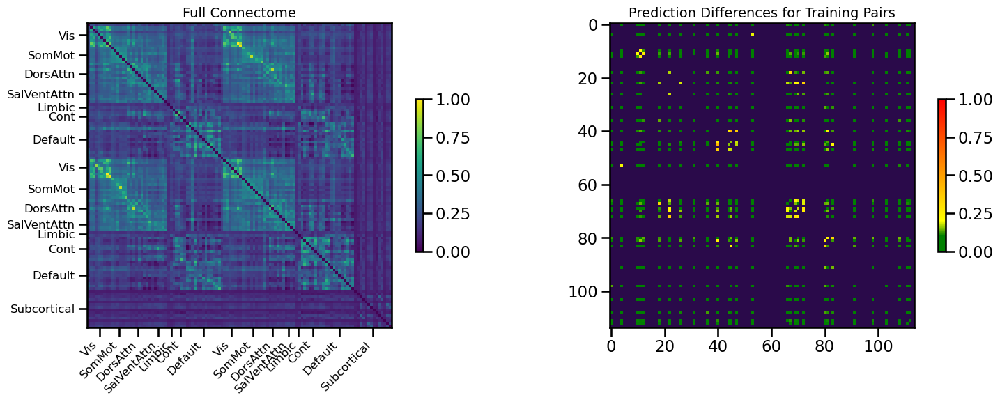

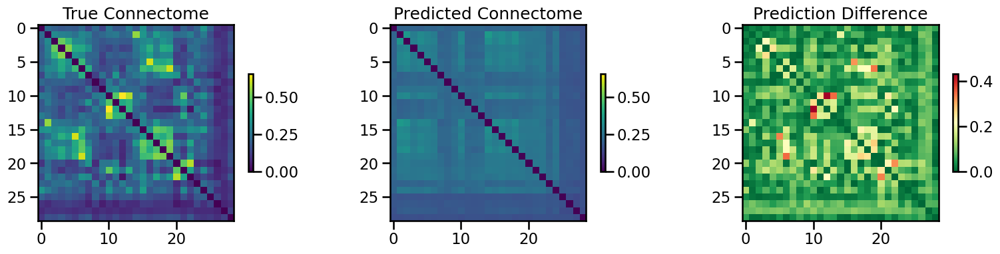

No scatter plot visualization for this model

TRAIN METRICS: {'mse': 0.0053825625464885085, 'mae': 0.050634171030709337, 'r2': 0.6463756145942009, 'pearson_corr': 0.8539296469836051, 'geodesic_distance': 8.328390213486664}
TEST METRICS: {'mse': 0.009077606887351606, 'mae': 0.07212201354952219, 'r2': 0.28504947073317377, 'pearson_corr': 0.5813013090839533, 'geodesic_distance': 6.554583899132063}
BEST VAL SCORE -0.010471513271177395
BEST MODEL HYPERPARAMS {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': 0.6, 'device': 'cuda', 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.01, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 5, 'max_leaves': None, 'min

<Figure size 1000x700 with 0 Axes>

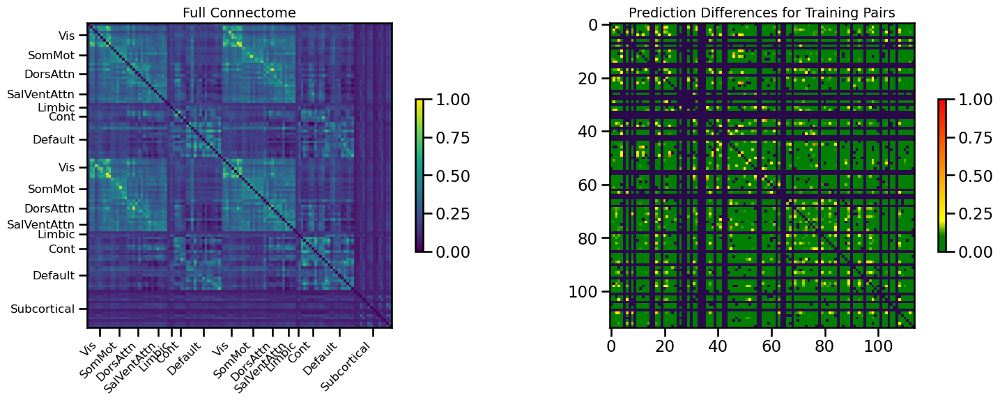

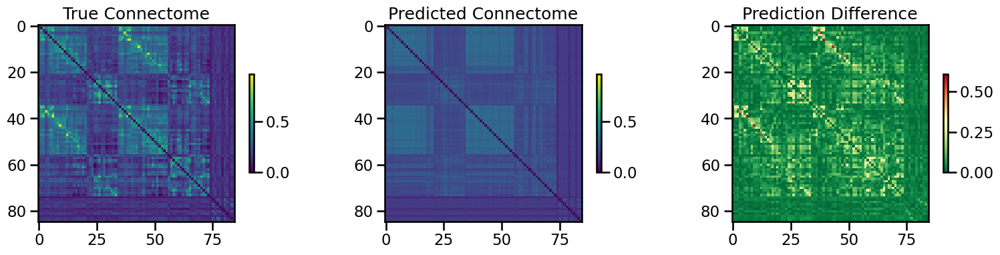

No scatter plot visualization for this model


<Figure size 1000x700 with 0 Axes>

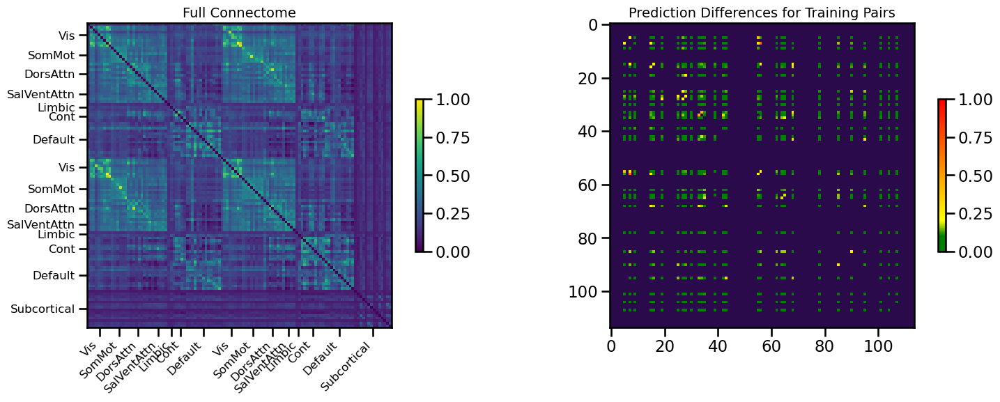

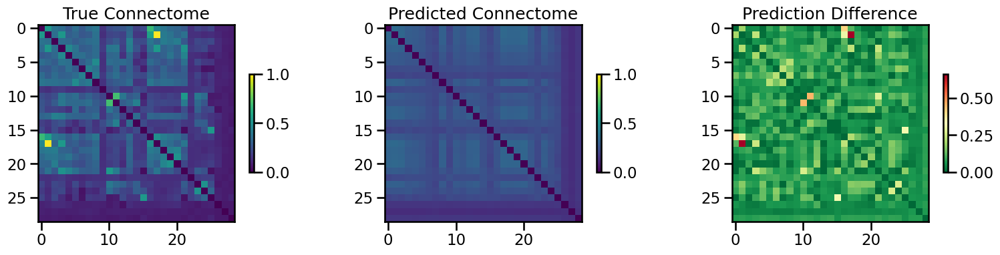

No scatter plot visualization for this model

TRAIN METRICS: {'mse': 0.00592067209155332, 'mae': 0.05302170187444675, 'r2': 0.5646662027461942, 'pearson_corr': 0.8019051556227558, 'geodesic_distance': 8.230933703255072}
TEST METRICS: {'mse': 0.010150730411316823, 'mae': 0.07868725272470706, 'r2': 0.3776626801919437, 'pearson_corr': 0.6622592059372052, 'geodesic_distance': 4.7073401896892255}
BEST VAL SCORE -0.010374177771524233
BEST MODEL HYPERPARAMS {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': 0.6, 'device': 'cuda', 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.01, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 5, 'max_leaves': None, 'min_ch

<Figure size 1000x700 with 0 Axes>

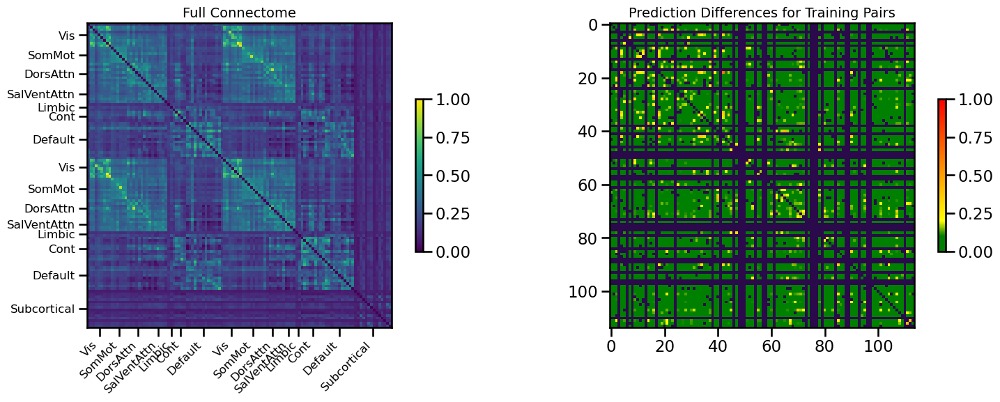

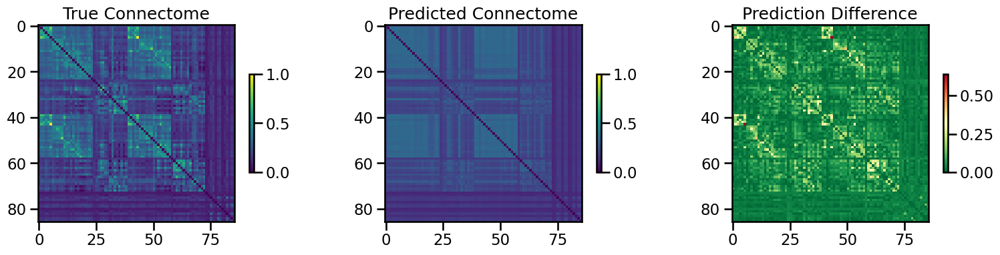

No scatter plot visualization for this model


<Figure size 1000x700 with 0 Axes>

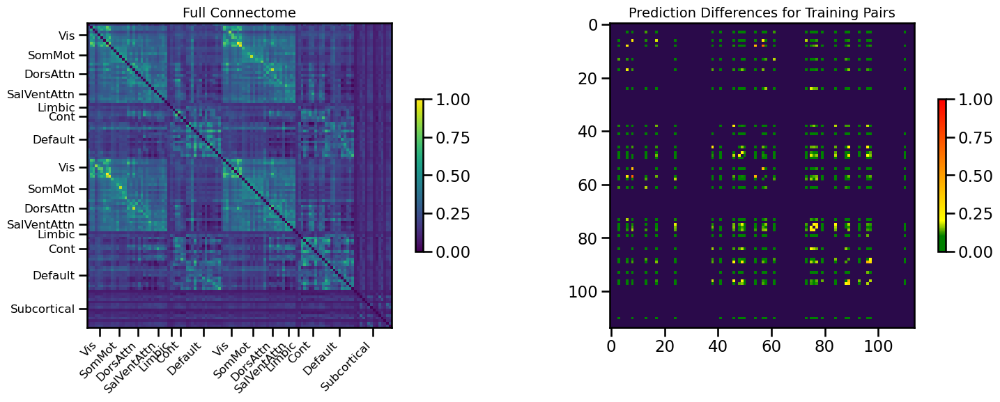

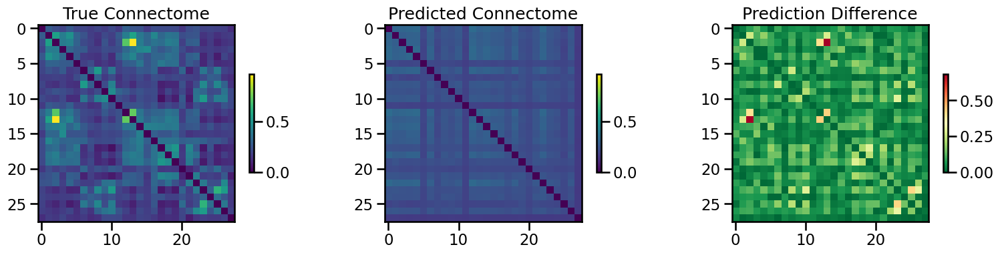

No scatter plot visualization for this model

TRAIN METRICS: {'mse': 0.004998147539601883, 'mae': 0.04872468211441351, 'r2': 0.6525978404571564, 'pearson_corr': 0.8484512812334314, 'geodesic_distance': 8.137861894475453}
TEST METRICS: {'mse': 0.011344650973052475, 'mae': 0.0782996011022232, 'r2': 0.12844763353880617, 'pearson_corr': 0.3702535874289053, 'geodesic_distance': 3.954147749932815}
BEST VAL SCORE -0.00936670847035243
BEST MODEL HYPERPARAMS {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': 0.6, 'device': 'cuda', 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.01, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 5, 'max_leaves': None, 'min_chi

<Figure size 1000x700 with 0 Axes>

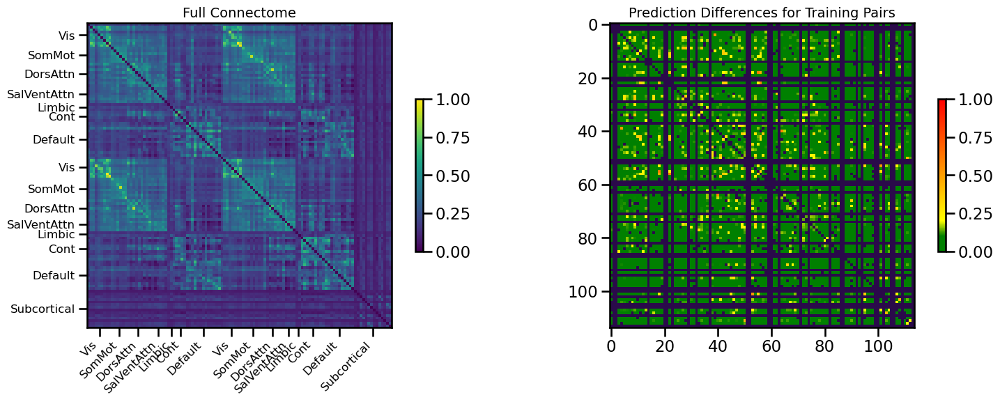

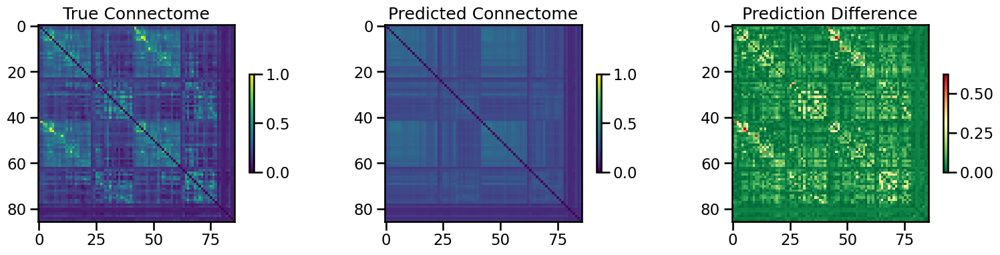

No scatter plot visualization for this model


<Figure size 1000x700 with 0 Axes>

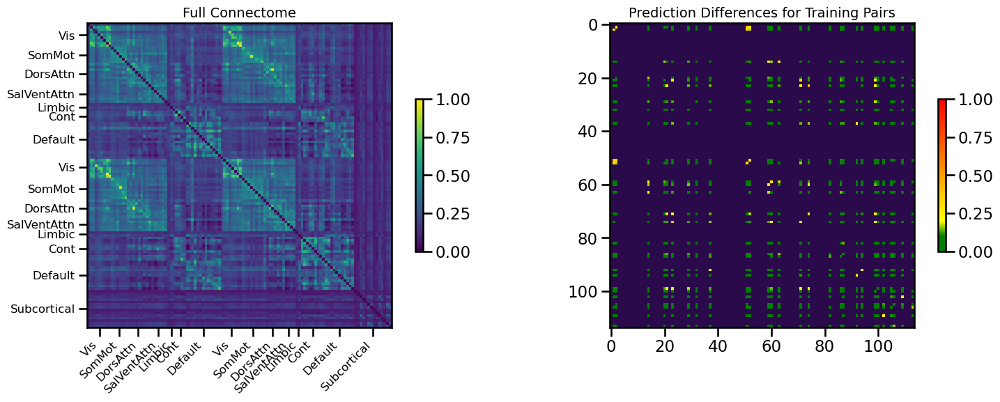

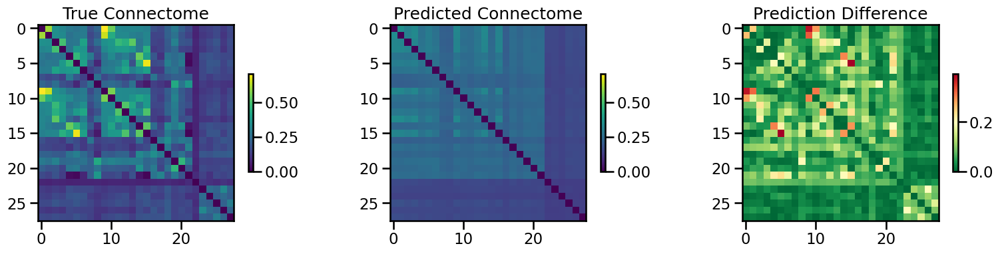

No scatter plot visualization for this model

TRAIN METRICS: {'mse': 0.006559550108317932, 'mae': 0.056117864282469704, 'r2': 0.5551384509911272, 'pearson_corr': 0.7958448055931916, 'geodesic_distance': 8.417240854480596}
TEST METRICS: {'mse': 0.0080667572129851, 'mae': 0.06368082846033168, 'r2': 0.38675044207273335, 'pearson_corr': 0.6453875751147239, 'geodesic_distance': 5.189189290667566}
BEST VAL SCORE -0.010780497600696591
BEST MODEL HYPERPARAMS {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': 0.6, 'device': 'cuda', 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.01, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 5, 'max_leaves': None, 'min_ch

199975

<Figure size 1000x700 with 0 Axes>

In [22]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S100',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='expression',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('bayes', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='xgboost',
              use_gpu=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()